In [1]:
import csv
import math
import random
from matplotlib import pyplot as plt, pyplot
import numpy as np

In [2]:
def calcPerm(graph, perm):
	return sum([graph[perm[i]][perm[i + 1]] for i in range(perm.__len__() - 1)]) + graph[perm[perm.__len__() - 1]][
		perm[0]]

def permute(perm, i, j):
	pc = perm.copy()
	pc[i], pc[j] = perm[j], perm[i]
	return pc

def permuteConsec(perm, i):
	return permute(perm, i % len(perm), (i + 1) % len(perm))

def insert(perm, i, j):
	pc = perm.copy()
	pc.insert(j, pc.pop(i))
	return pc

def opt2(perm, i, j):
	pc = perm.copy()
	for k in range(abs(j - i) // 2 + 1):
		pc = permute(pc, (i + k) % len(pc), (j - k) % len(pc))
	return pc

def randomVoisinChooseV(perm, choice):
	a = random.randint(0, len(perm) - 1)
	b = random.randint(0, len(perm) - 1)
	if choice == 0:
		return permute(perm, a, b)
	elif choice == 1:
		return permuteConsec(perm, a)
	elif choice == 2:
		return insert(perm, a, b)
	else:
		return opt2(perm, a, b)

def randomVoisin(perm):
	return randomVoisinChooseV(perm, random.randint(0, 3))

def getClosest(i, l):
	m = l[0]
	for j in l:
		if distEucl[i][j] < distEucl[i][m]:
			m = j
	return m


def calcGluttonPerm(dists, start):
	perm = [start]
	for i in range(dists.__len__() - 1):
		perm.append(getClosest(perm[i], [j for j in range(dists.__len__()) if j not in perm]))
	return perm

def showPerm(perm):
	plt.scatter([pos[i][0] for i in perm], [pos[i][1] for i in perm])
	pyplot.plot([pos[perm[i]][0] for i in range(perm.__len__())] + [pos[perm[0]][0]],
				[pos[perm[i]][1] for i in range(perm.__len__())] + [pos[perm[0]][1]])
	plt.show()


def recuitSimule(dists, x0, T0, L, alpha, K):
	T = T0
	xBest = x0
	FBest = calcPerm(dists, xBest)
	xN = xBest
	k = 0
	n = 0
	while k < K:
		xTmp = randomVoisinChooseV(xN, 3)
		FTmp = calcPerm(dists, xTmp)
		deltaF = FTmp - FBest
		if deltaF <= 0:
			xN = xTmp
			if FTmp < FBest:
				xBest = xTmp
				FBest = FTmp
				k = 0
			else:
				k += 1
		else:
			if random.random() < math.exp(-deltaF / T):
				xN = xTmp
			k += 1
		n += 1
		if n % L == 0:
			T = T * alpha
	return xBest, FBest


def surface(initialPerm, alphaTarget, kTarget, LTarget):
	"""
	Cette fonction permet de tracer une surface avec les valeurs de k, de
	alpha en abscisse et ordonnee et la valeur du chemin en axe z. Cela
	permet de trouver pour quelles valeurs de k et de alpha , la fonction
	recuit simule optimise le mieux . Cela permet de faire un choix sur les
	parametres afin de mieux optimiser
	"""
	# bp = [calcGluttonPerm(distEucl, i) for i in range(250)]
	T_0 = 10000
	# vect_L = np.linspace(max(1, LTarget-1), min(30, LTarget+1), 3)
	# Vecteur des valeurs de alpha et de k
	vect_alpha = np.linspace(max(alphaTarget - 0.05, 0), min(0.999, alphaTarget + 0.05, 10))
	vect_k = np.linspace(max(5, kTarget - 5), kTarget + 5, 10)
	# Initialisation du vecteur qui contient la longueur des chemins
	vect_F = np.zeros((len(vect_alpha), len(vect_k)))
	alphaMin = 0
	kMin = 0
	LMin = 0
	FMin = 1000000000
	permMin = []
	# Double boucle sur les 2 parametres a optimiser
	for i_alpha in range(len(vect_alpha)):
		for i_k in range(len(vect_k)):
			list_F = []
			# On applique le recuit simule
			for i in range(20):
				Fc = recuitSimule(distEucl, initialPerm, T_0, LTarget, vect_alpha[i_alpha], vect_k[i_k])
				list_F.append(Fc[1])
				if Fc[1] < FMin:
					FMin = Fc[1]
					alphaMin = vect_alpha[i_alpha]
					kMin = vect_k[i_k]
					permMin = Fc[0]
					LMin = LTarget
			# On garde le minimum du recuit
			F = min(list_F)
			vect_F[i_alpha, i_k] = F
	# Graphe en 3D
	fig, ax = plt.subplots(subplot_kw={"projection": "3d"})
	vect_k, vect_alpha = np.meshgrid(vect_k, vect_alpha)
	S = ax.plot_surface(vect_alpha, vect_k, vect_F, cmap="plasma")
	# Vue du dessous
	ax.view_init(-90, 90, 0)
	fig.colorbar(S)
	print("alpha min :", alphaMin, "; k min :", kMin, "; F min :", FMin, "; L min :", LMin, "; perm min :", permMin)
	plt.show()
	# showPerm(permMin)
	return alphaMin, kMin, FMin, LMin, permMin


In [3]:
I = float('inf')
pos = []

with open('defi250.csv', 'r') as f:
	reader = csv.reader(f, delimiter=';')
	l = list(reader)[1:]
	for x in range(l.__len__()):
		pos.append((float(l[x][0]), float(l[x][1])))

distEucl = [[math.sqrt((pos[i][0] - pos[j][0]) ** 2 + (pos[i][1] - pos[j][1]) ** 2) for j in range(pos.__len__())] for i
			in range(pos.__len__())]
for x in range(distEucl.__len__()):
	distEucl[x][x] = I

In [4]:
print("permutation de base (0, 1, ..., 249) :", calcPerm(distEucl, [i for i in range(distEucl.__len__())]))

permutation de base (0, 1, ..., 249) : 134.8402613136102


In [5]:
test = [i for i in range(10)]

print("TESTS")
print("Base", test)
print("2-Opt(du 2e au 7e)", opt2(test, 2, 7))
print("Permute(2e et 7e)", permute(test, 2, 7))
print("PermuteConsec(2e et 3e)", permuteConsec(test, 2))
print("PermuteConsec(7e et 8e)", permuteConsec(test, 7))
print("Insert(2e en 7e)", insert(test, 2, 7))

TESTS
Base [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
2-Opt(du 2e au 7e) [0, 1, 7, 6, 5, 4, 3, 2, 8, 9]
Permute(2e et 7e) [0, 1, 7, 3, 4, 5, 6, 2, 8, 9]
PermuteConsec(2e et 3e) [0, 1, 3, 2, 4, 5, 6, 7, 8, 9]
PermuteConsec(7e et 8e) [0, 1, 2, 3, 4, 5, 6, 8, 7, 9]
Insert(2e en 7e) [0, 1, 3, 4, 5, 6, 7, 2, 8, 9]


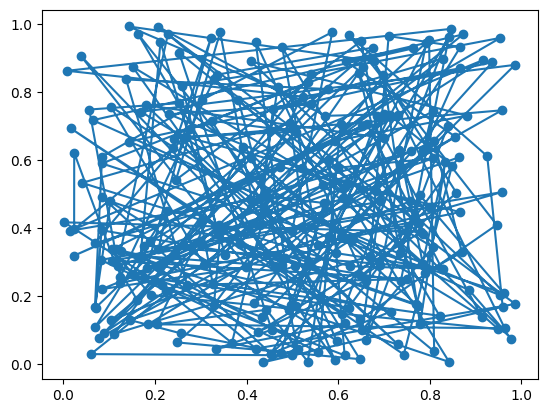

random : 129.2798208422711


In [6]:
randomPerm = [i for i in range(250)]
for i in range(100):
	randomPerm = randomVoisin(randomPerm)

showPerm(randomPerm)
print("random :", calcPerm(distEucl, randomPerm))

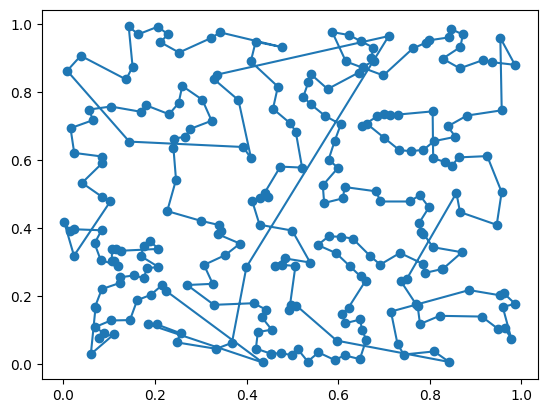

glouton ville 0 : 14.732246704694951


In [7]:
gluttonPerm = [i for i in range(250)]
for i in range(len(gluttonPerm) - 1):
	closest = getClosest(gluttonPerm[i], gluttonPerm[i + 1:])
	gluttonPerm = insert(gluttonPerm, gluttonPerm.index(closest), i + 1)

showPerm(gluttonPerm)
print("glouton ville 0 :", calcPerm(distEucl, gluttonPerm))

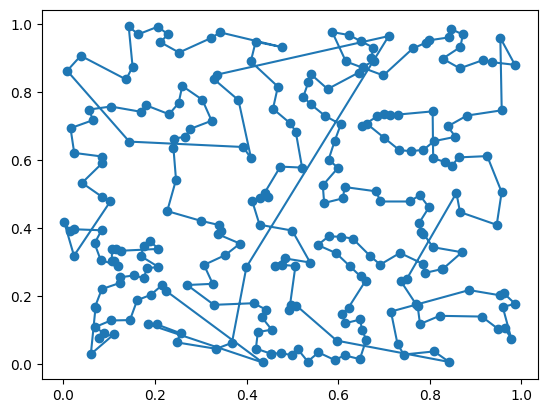

glouton ville 0 : 14.732246704694951


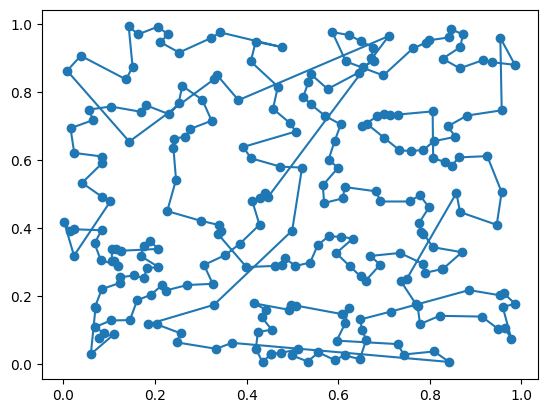

glouton ville 1 : 14.361853447994136


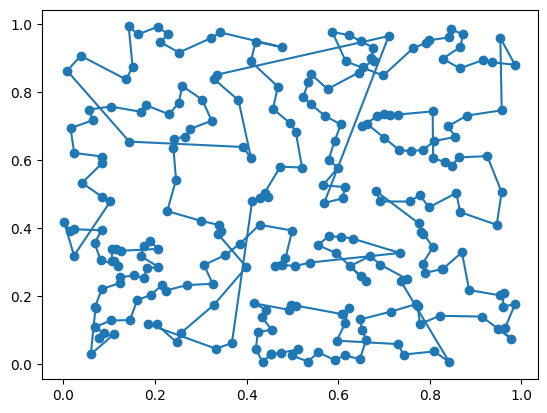

glouton ville 2 : 14.423641774050353


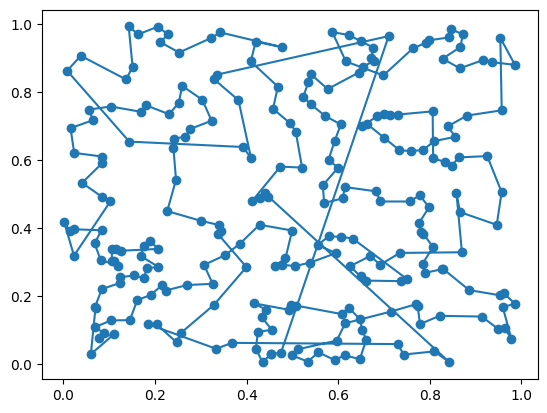

glouton ville 3 : 15.15484695331384


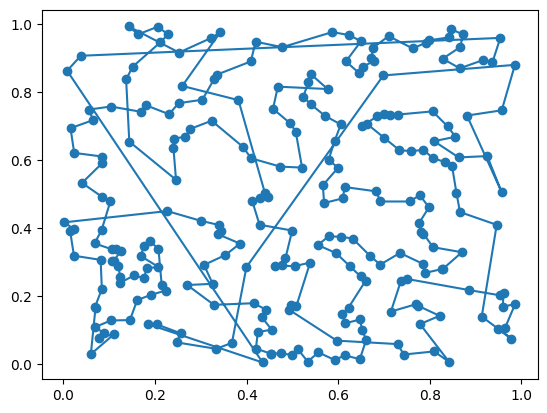

glouton ville 4 : 16.03734436379536


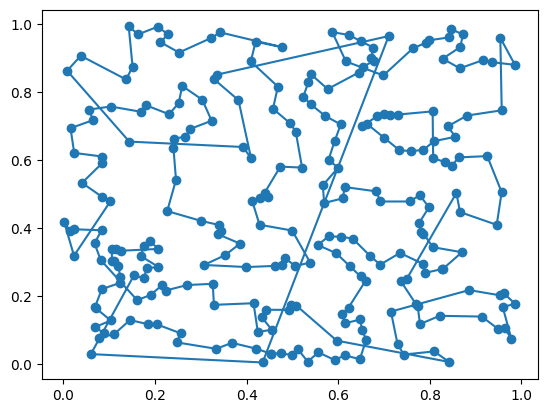

glouton ville 5 : 14.811691490930272


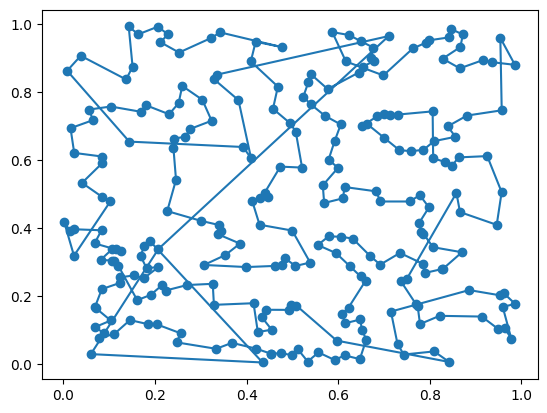

glouton ville 6 : 15.03775070036011


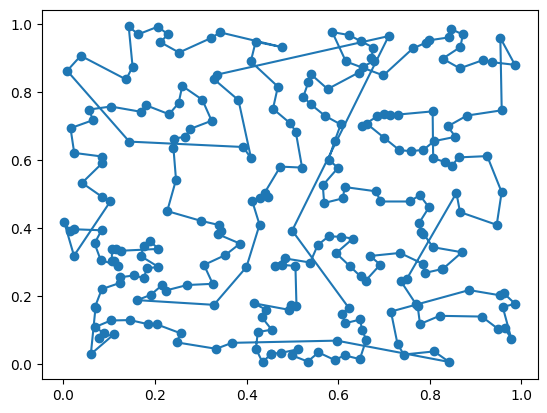

glouton ville 7 : 14.359523460219854


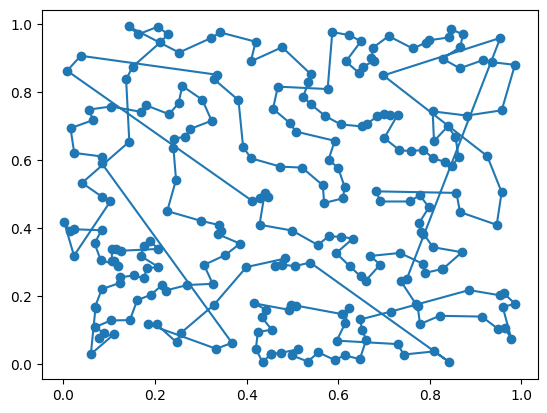

glouton ville 8 : 15.354920695011893


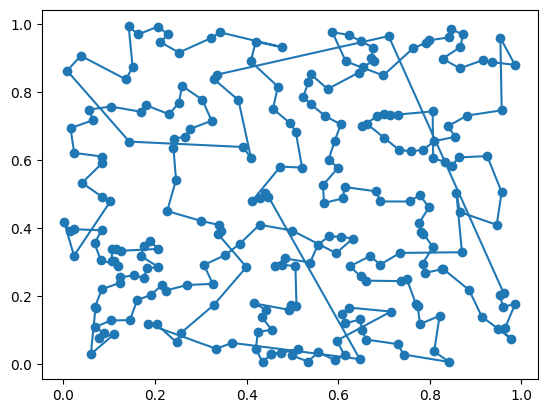

glouton ville 9 : 14.87609584326954


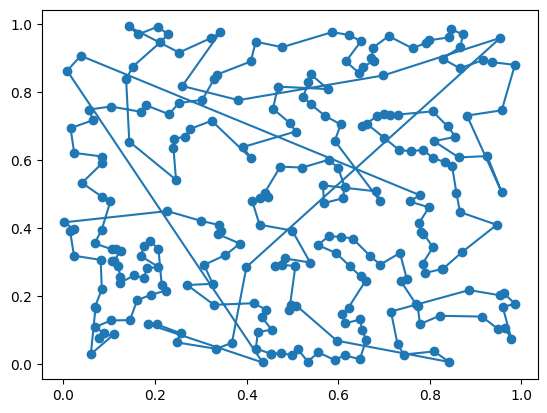

glouton ville 10 : 16.47421849945823


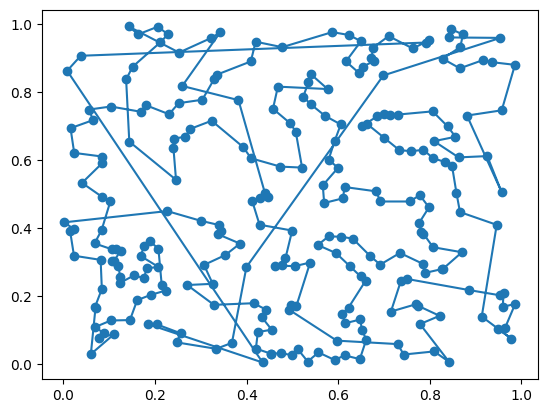

glouton ville 11 : 15.917979035449317


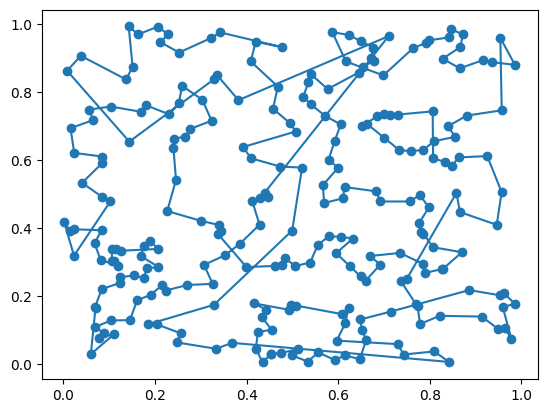

glouton ville 12 : 14.354206000585812


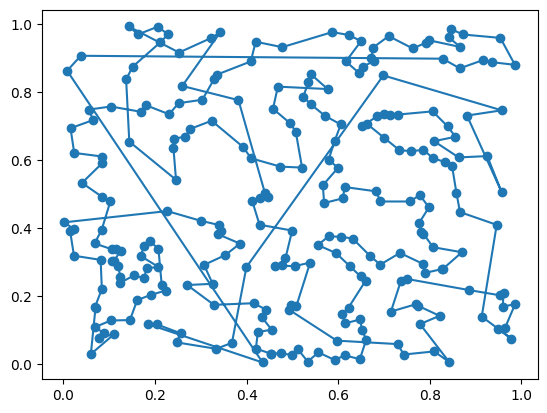

glouton ville 13 : 15.882702447663226


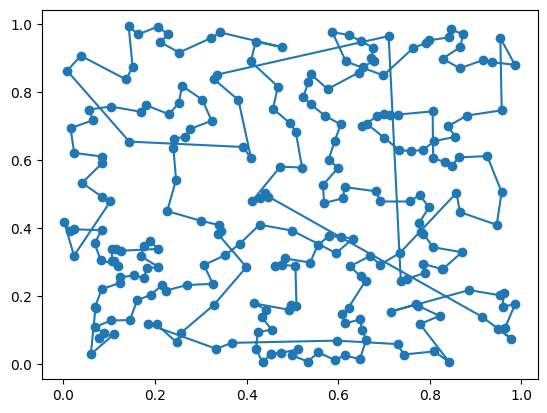

glouton ville 14 : 14.789061452013927


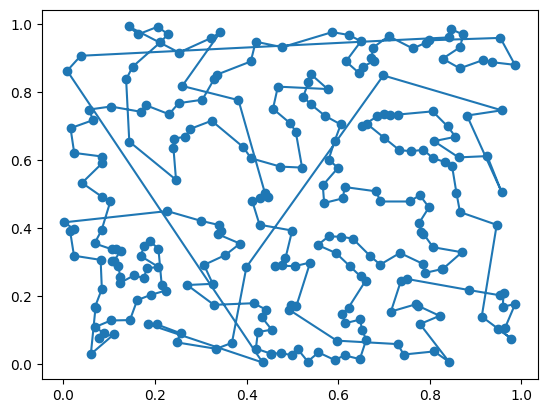

glouton ville 15 : 15.951098933033599


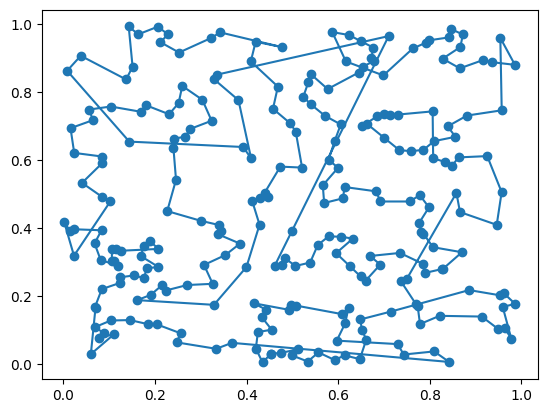

glouton ville 16 : 14.307540486691602


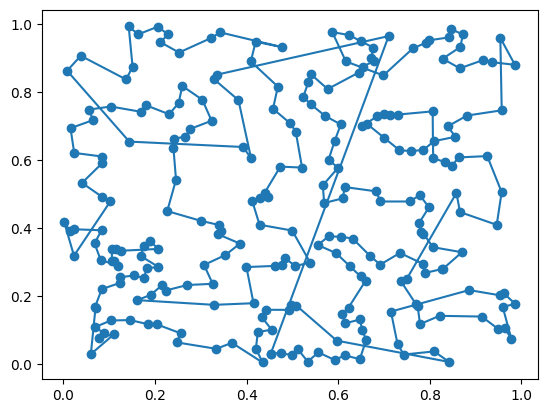

glouton ville 17 : 14.392280818931635


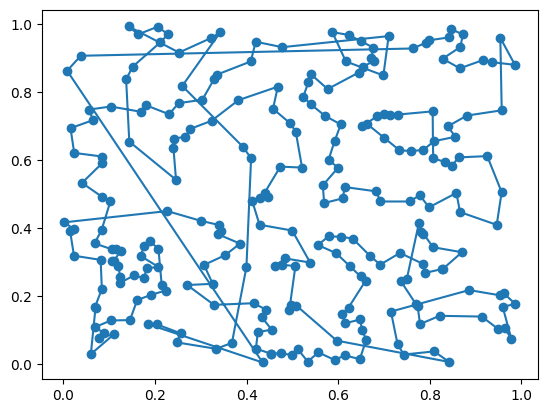

glouton ville 18 : 15.42238512558986


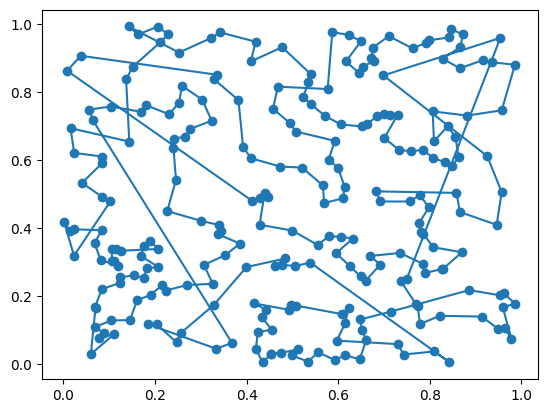

glouton ville 19 : 15.470095912171814


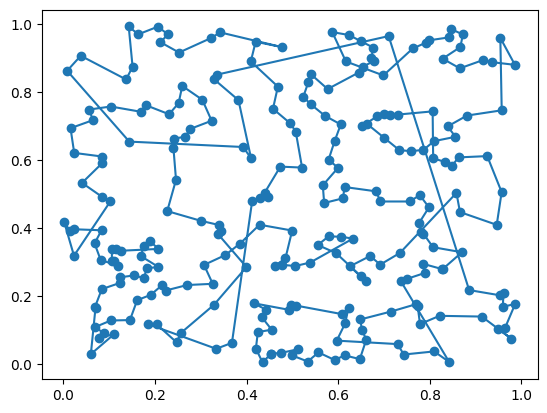

glouton ville 20 : 14.554059002419926


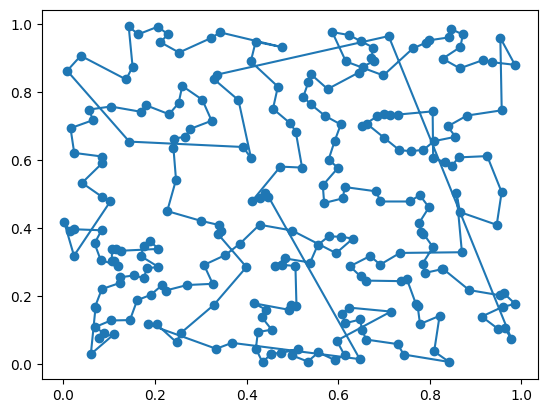

glouton ville 21 : 14.933620576212967


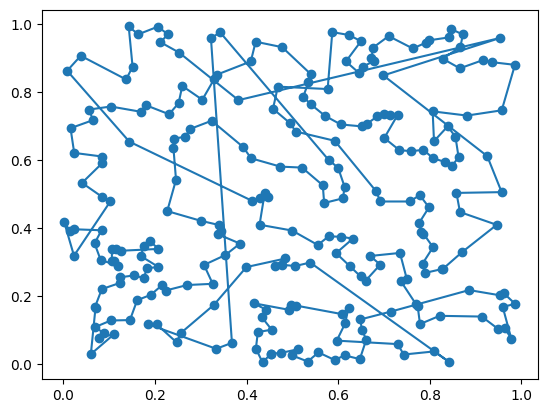

glouton ville 22 : 15.497749027483538


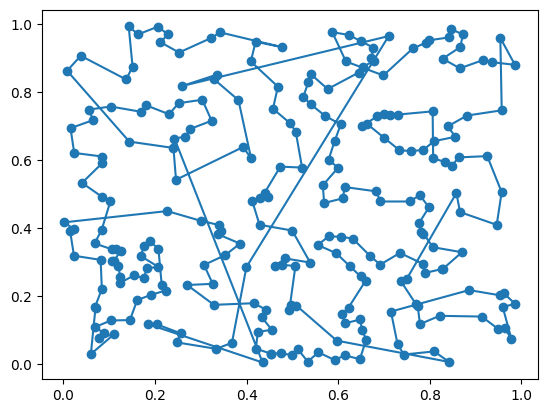

glouton ville 23 : 15.295893765419924


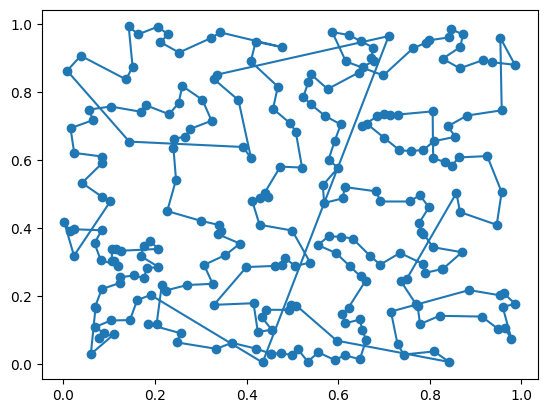

glouton ville 24 : 14.701154509084512


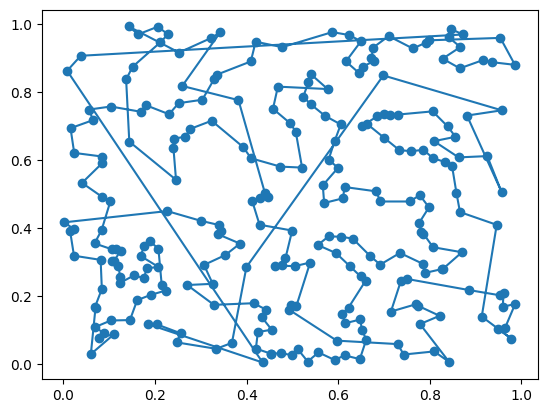

glouton ville 25 : 15.983063792828165


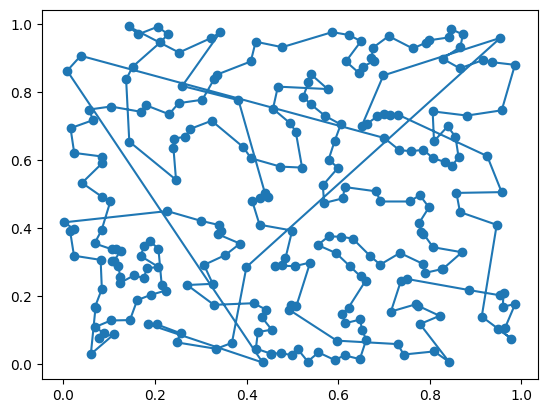

glouton ville 26 : 16.114495179517892


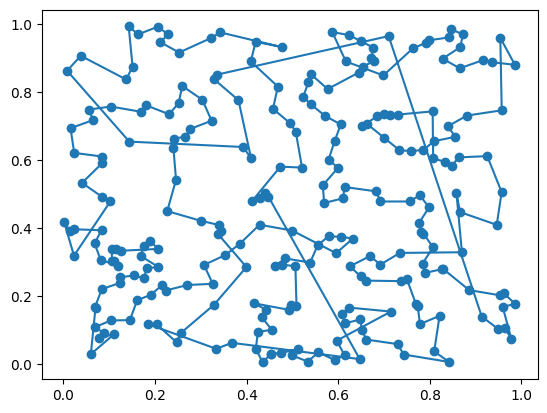

glouton ville 27 : 14.895409346412043


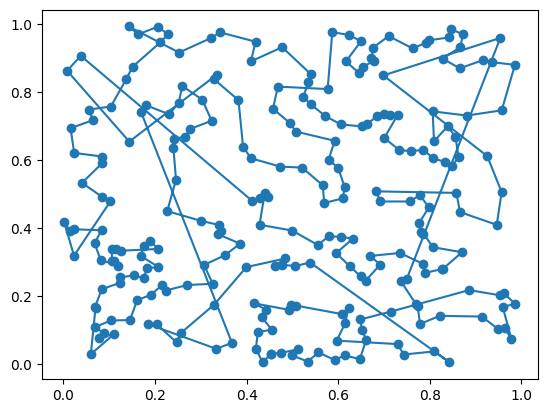

glouton ville 28 : 15.443240277505339


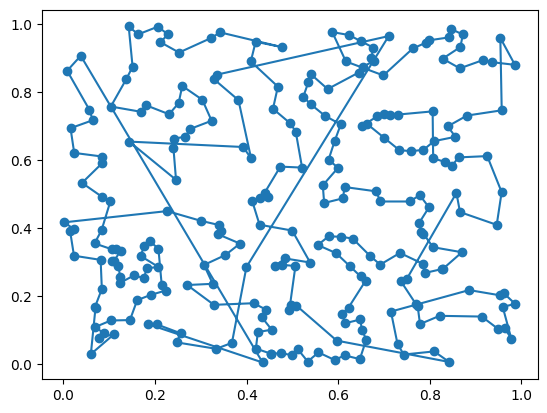

glouton ville 29 : 15.436418835405712


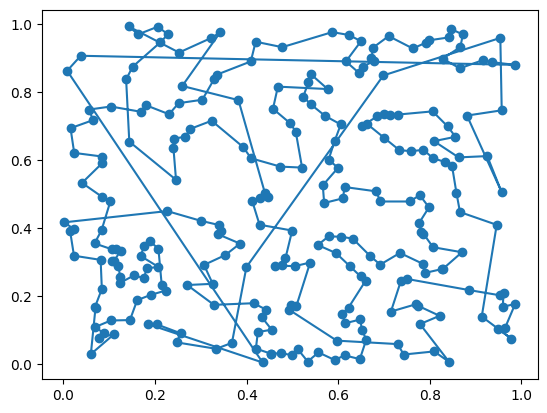

glouton ville 30 : 16.10972060717483


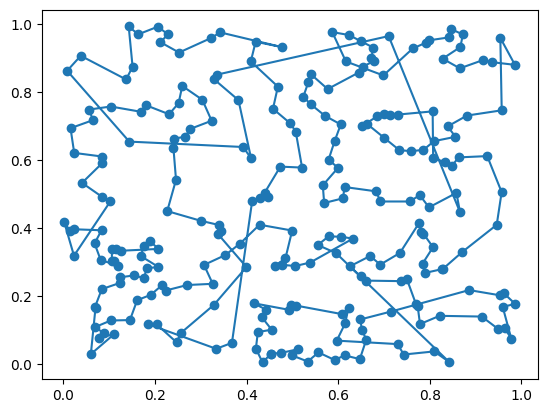

glouton ville 31 : 14.482041387471028


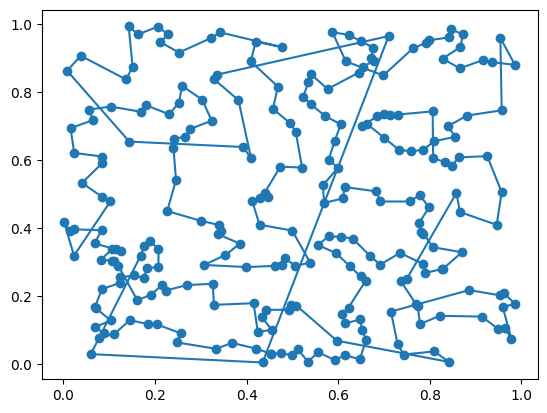

glouton ville 32 : 14.793991914020253


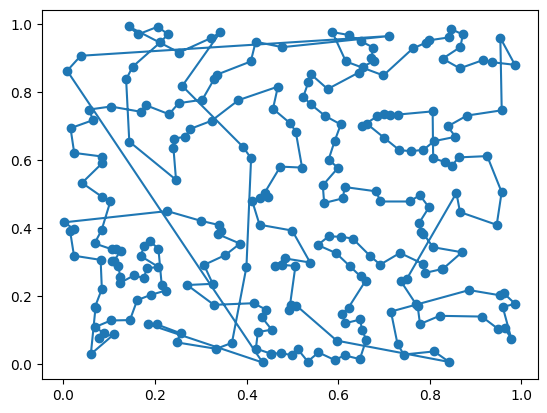

glouton ville 33 : 15.445961640131976


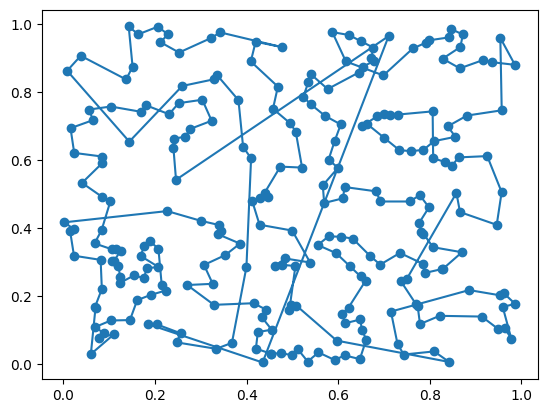

glouton ville 34 : 15.25146313705028


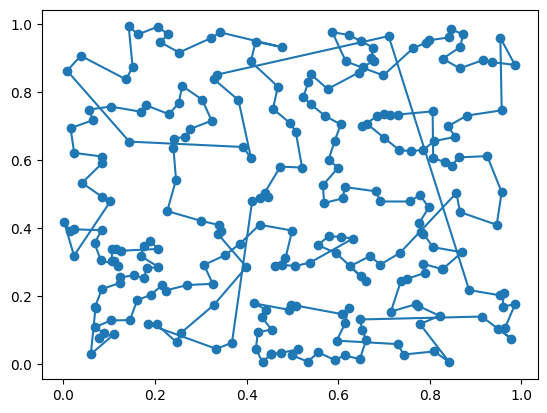

glouton ville 35 : 14.619047087418526


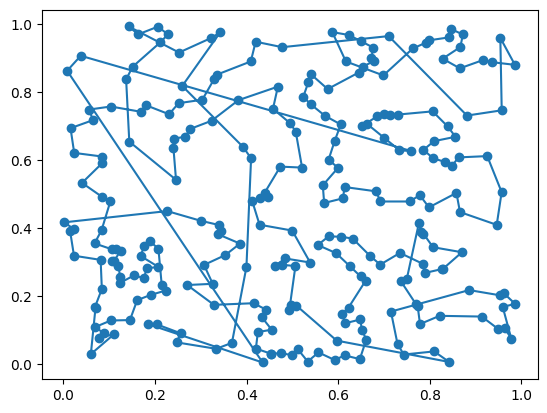

glouton ville 36 : 15.617148215508116


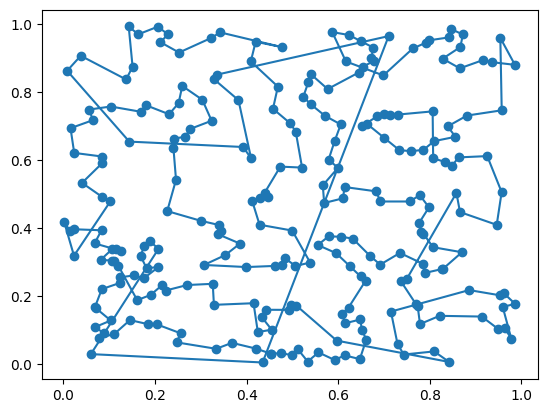

glouton ville 37 : 14.829331990962126


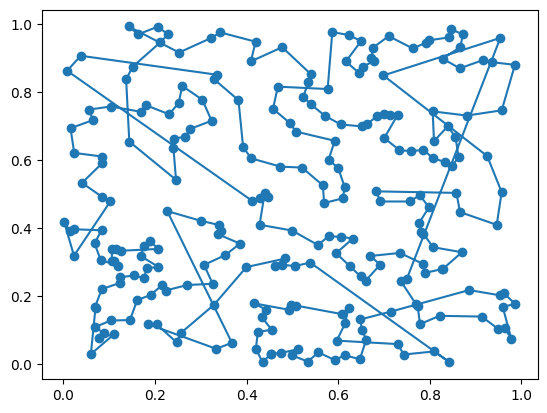

glouton ville 38 : 15.138666229613317


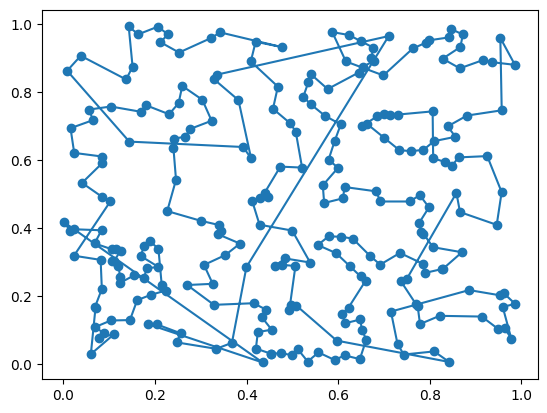

glouton ville 39 : 15.047709356434277


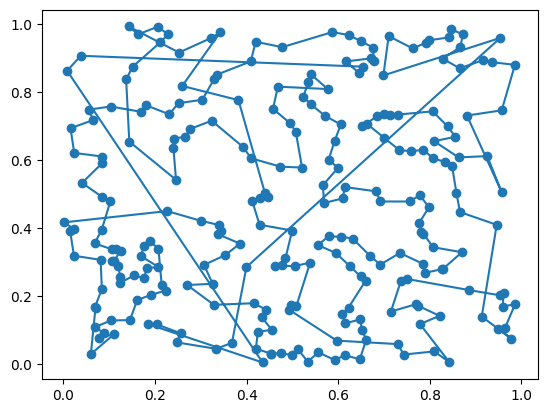

glouton ville 40 : 16.005975462820395


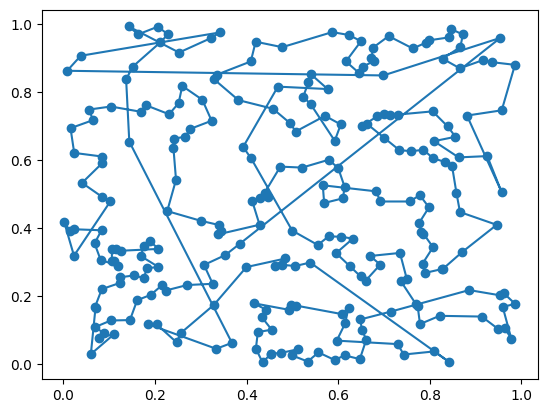

glouton ville 41 : 15.645550604307374


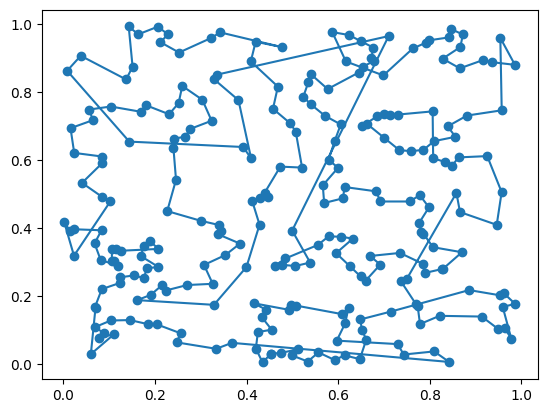

glouton ville 42 : 14.336368085779146


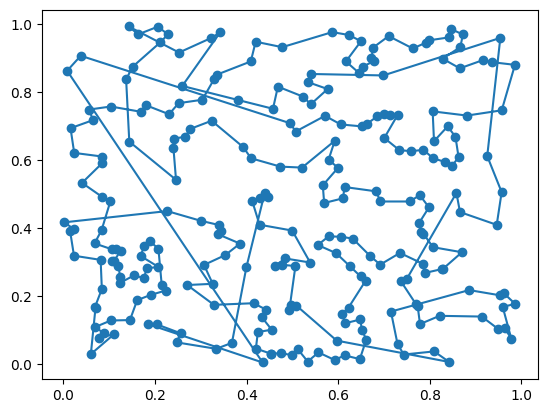

glouton ville 43 : 15.336893349300897


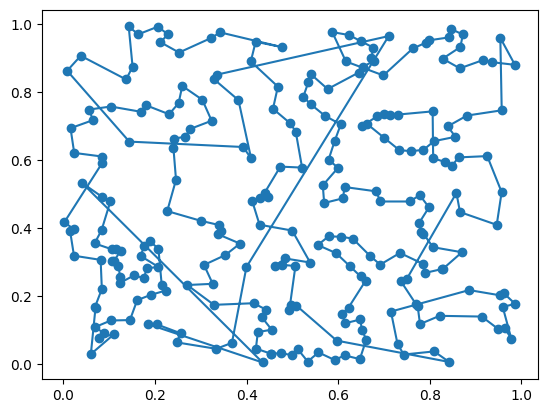

glouton ville 44 : 15.152943684277346


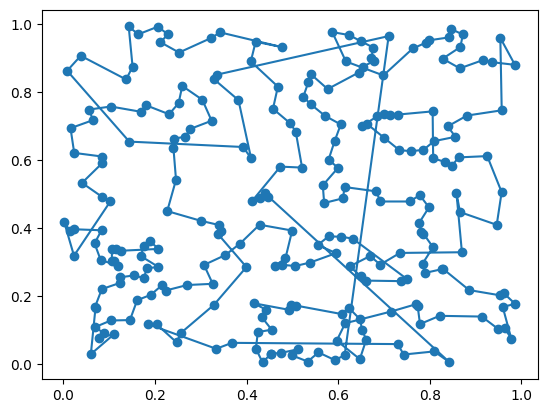

glouton ville 45 : 15.126444655745145


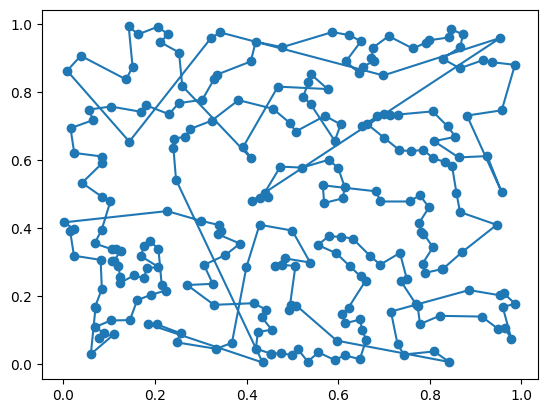

glouton ville 46 : 15.53370635412529


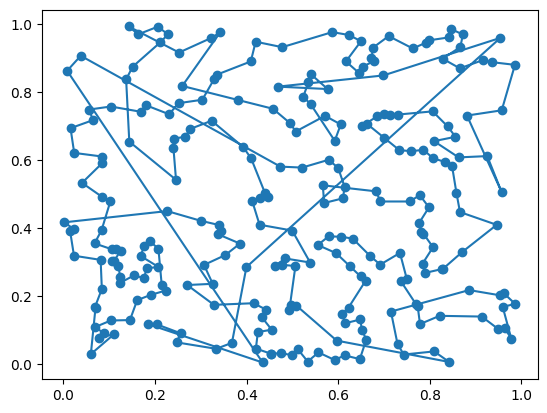

glouton ville 47 : 15.96317283356925


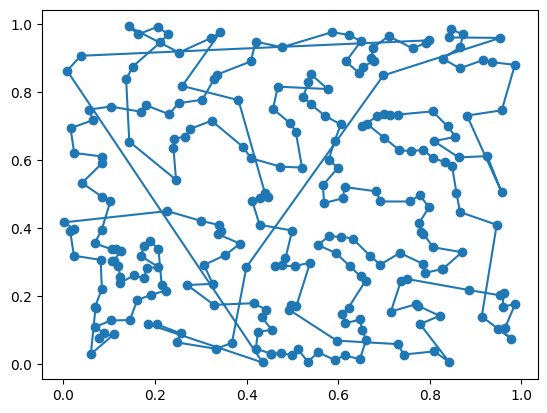

glouton ville 48 : 15.915791171624843


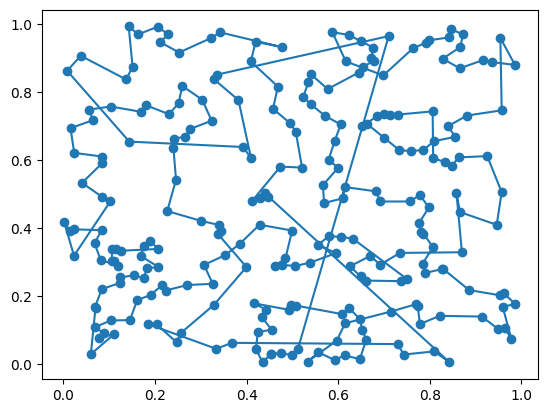

glouton ville 49 : 15.12047785426684


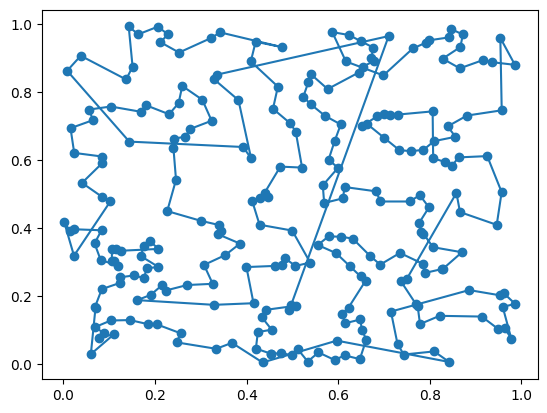

glouton ville 50 : 14.305354808457759


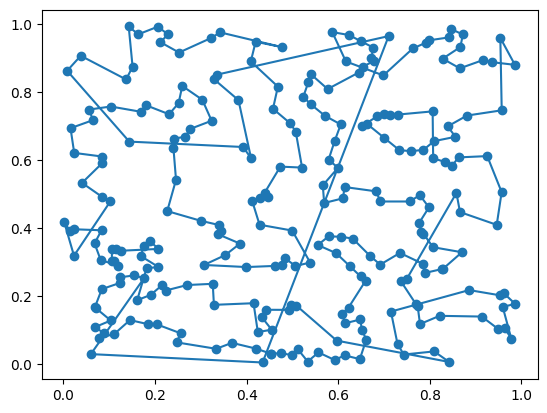

glouton ville 51 : 14.777760630280053


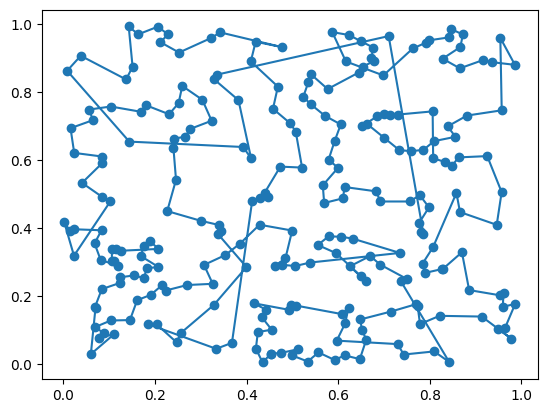

glouton ville 52 : 14.54142025444124


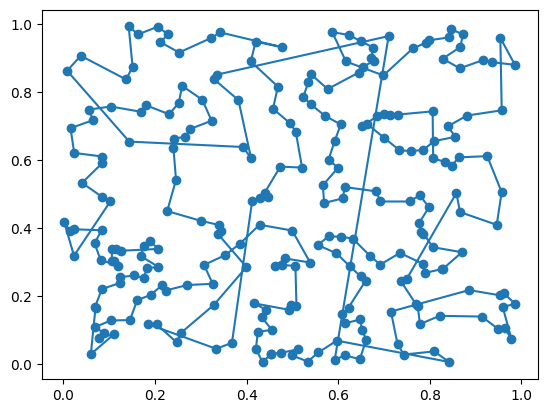

glouton ville 53 : 14.82619177204271


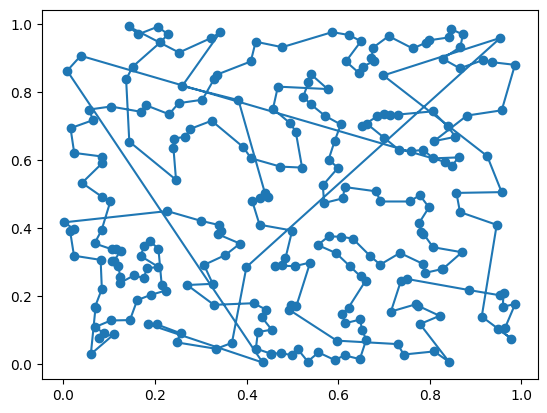

glouton ville 54 : 16.308872728939825


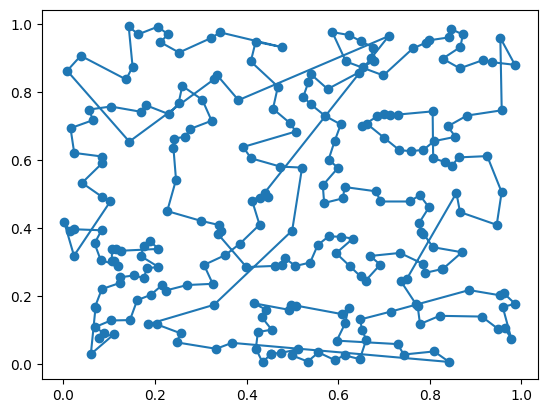

glouton ville 55 : 14.391393671928881


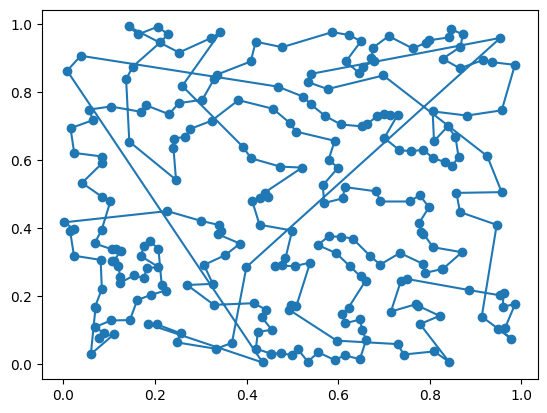

glouton ville 56 : 15.940224252651864


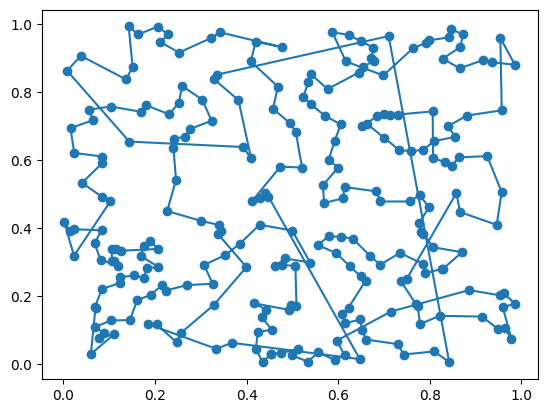

glouton ville 57 : 15.057878992064088


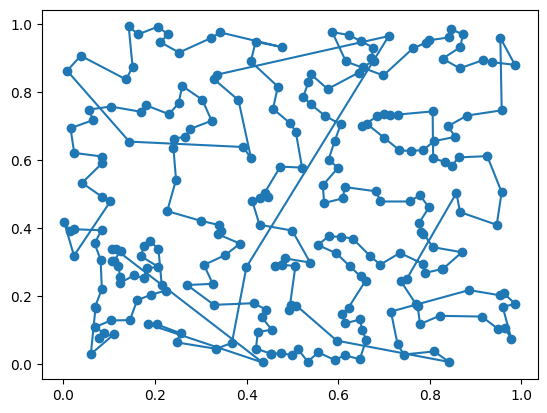

glouton ville 58 : 14.968953285866927


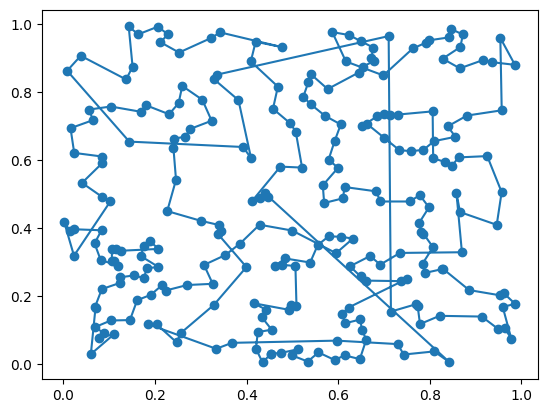

glouton ville 59 : 14.868969672107852


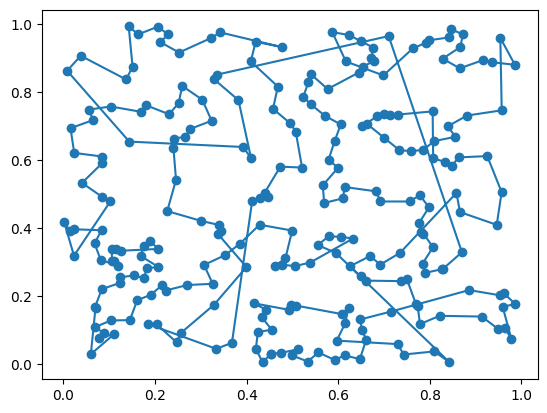

glouton ville 60 : 14.672342999793889


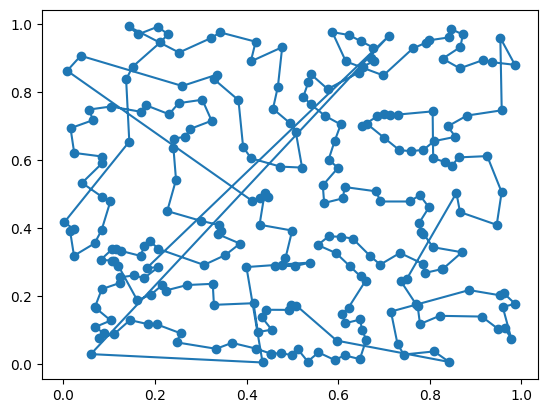

glouton ville 61 : 15.974467147445855


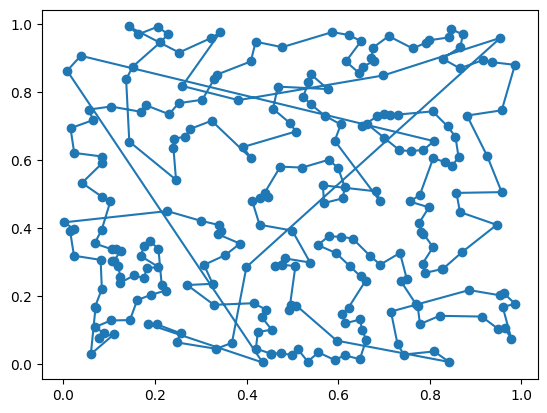

glouton ville 62 : 16.367321268514957


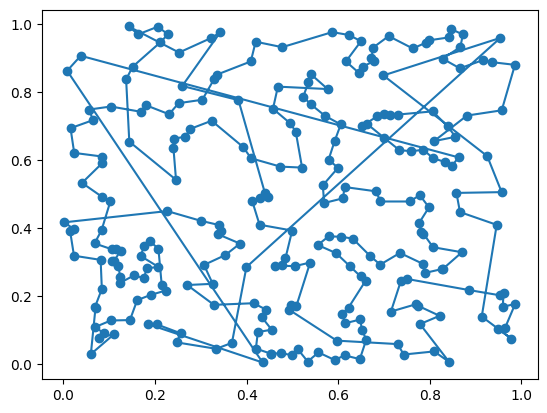

glouton ville 63 : 16.304249882475023


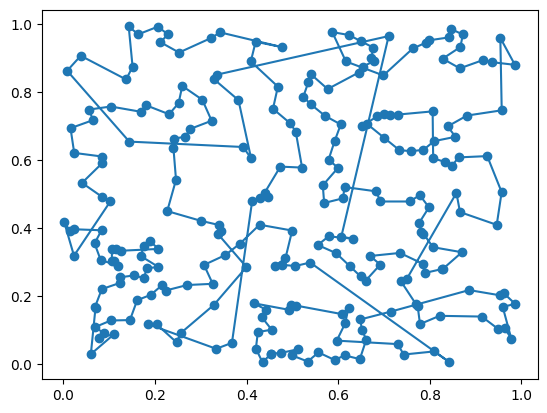

glouton ville 64 : 14.656370912328775


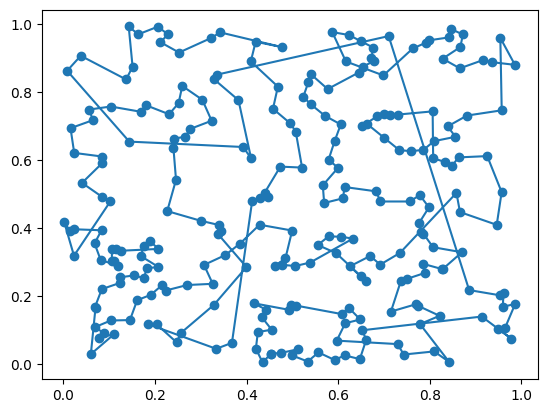

glouton ville 65 : 14.617442863695794


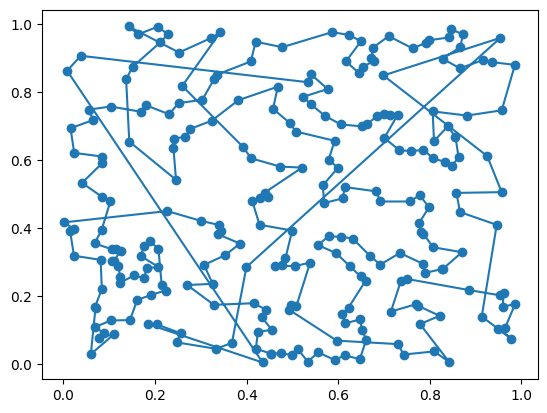

glouton ville 66 : 15.813117028680916


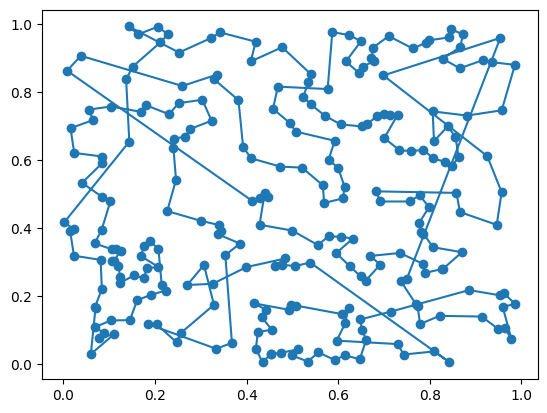

glouton ville 67 : 15.088063169834623


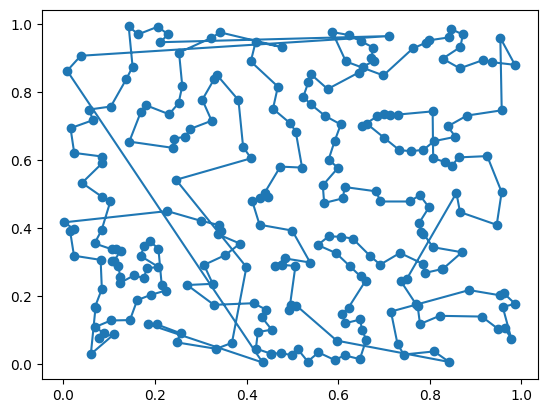

glouton ville 68 : 15.496437488605174


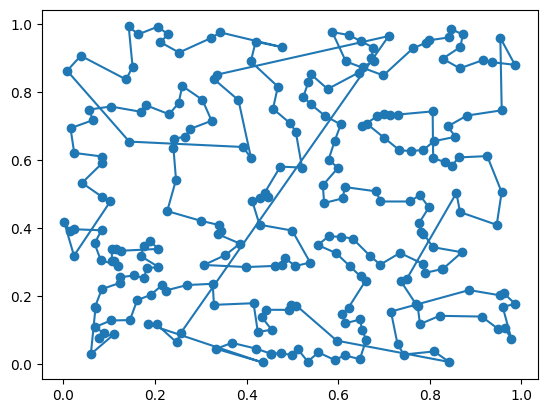

glouton ville 69 : 14.547559341838987


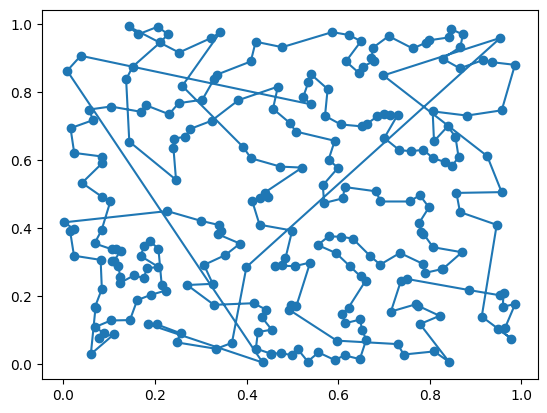

glouton ville 70 : 15.851031152513182


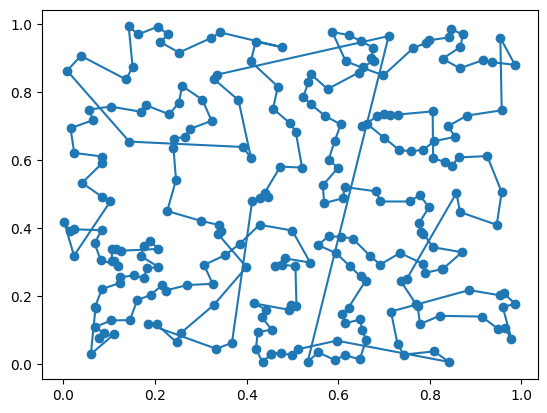

glouton ville 71 : 14.86375554345339


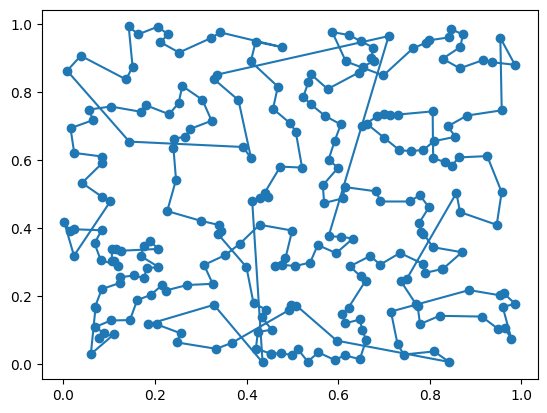

glouton ville 72 : 14.671443367434874


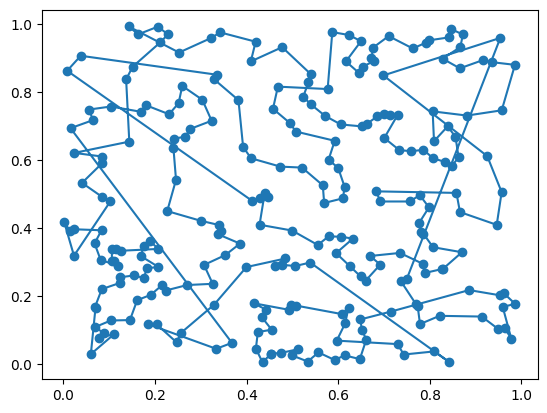

glouton ville 73 : 15.442864833249857


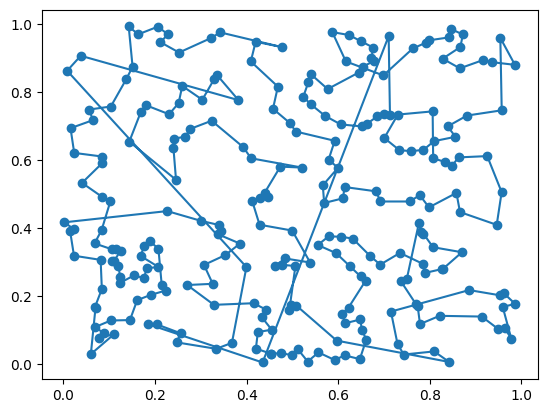

glouton ville 74 : 15.238948725938968


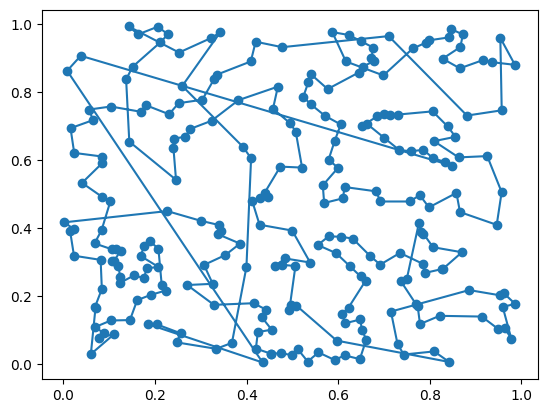

glouton ville 75 : 15.750775373284874


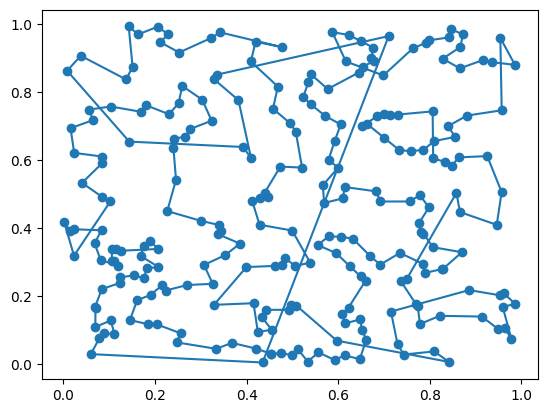

glouton ville 76 : 14.56337801075522


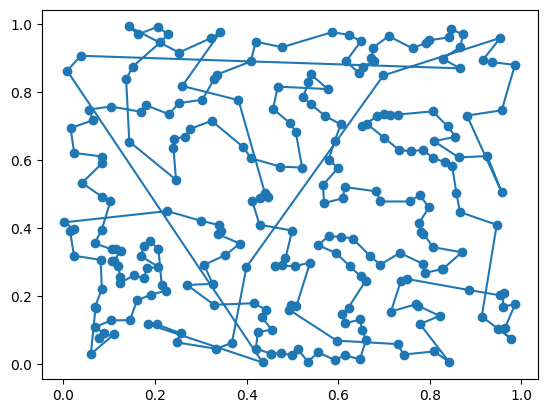

glouton ville 77 : 15.934344926627729


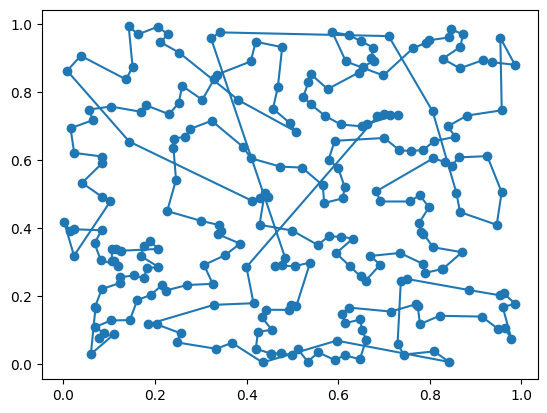

glouton ville 78 : 15.00702635417012


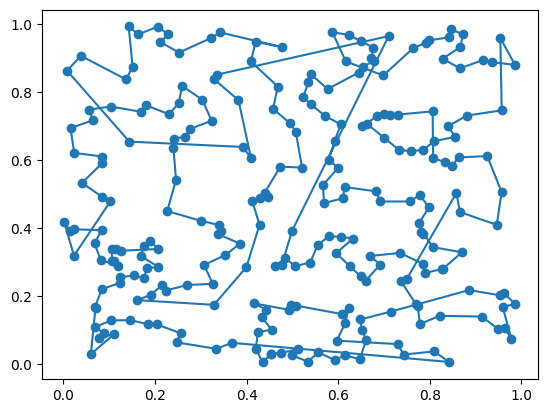

glouton ville 79 : 14.311875916972948


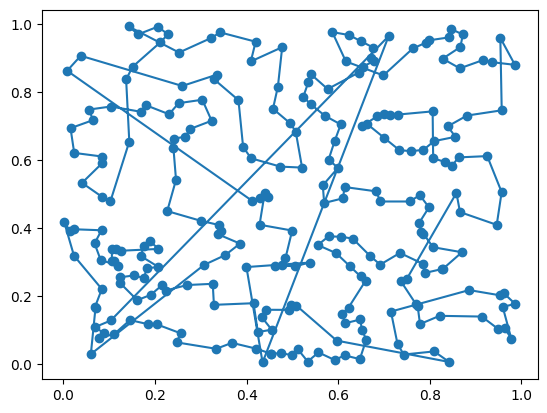

glouton ville 80 : 15.967616246206358


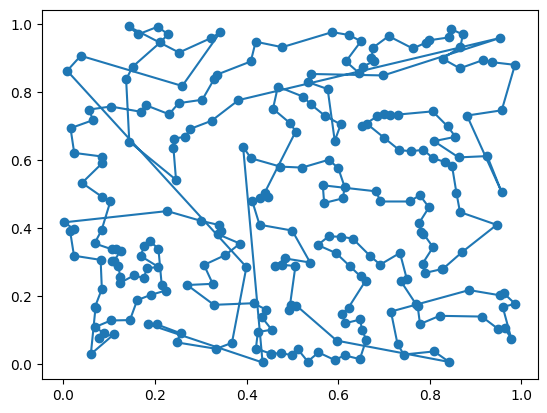

glouton ville 81 : 15.578883968803034


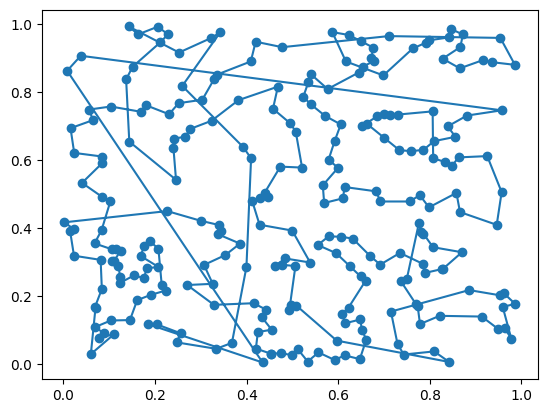

glouton ville 82 : 15.64727052431777


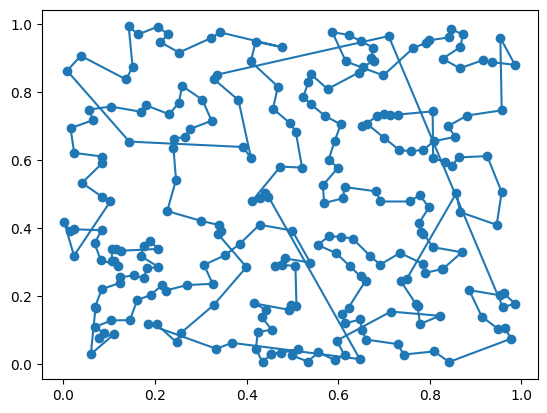

glouton ville 83 : 14.897126356354741


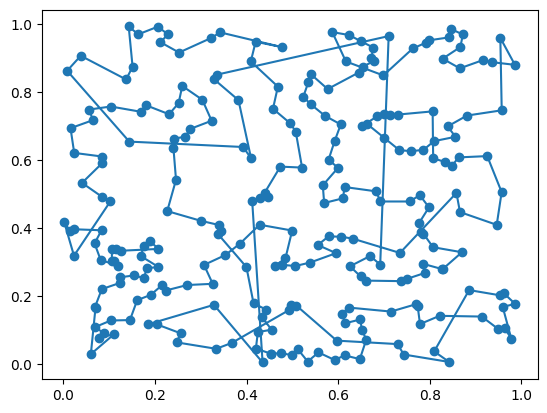

glouton ville 84 : 14.61170020903301


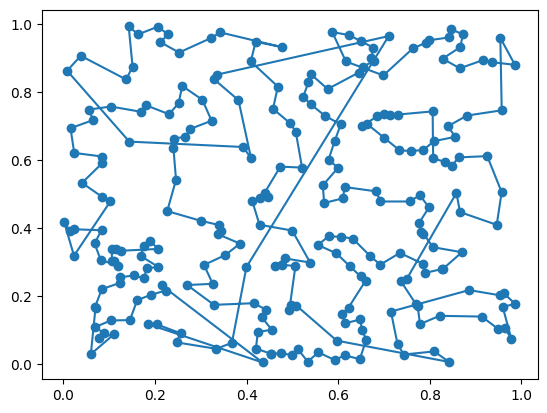

glouton ville 85 : 14.746921933305803


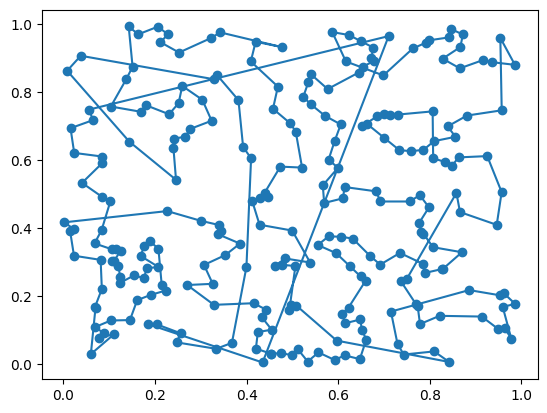

glouton ville 86 : 15.466175734148136


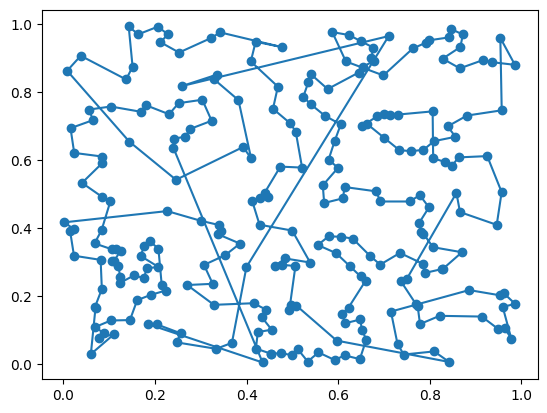

glouton ville 87 : 15.257562431013586


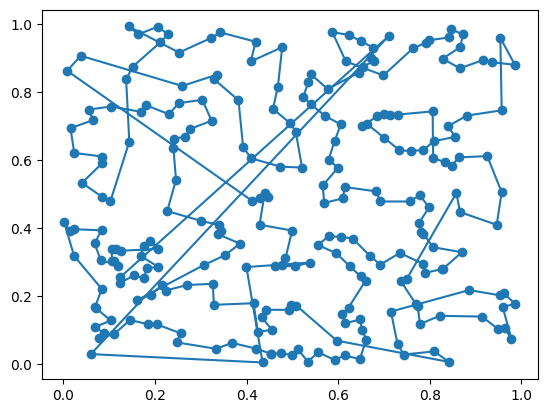

glouton ville 88 : 16.047844467688883


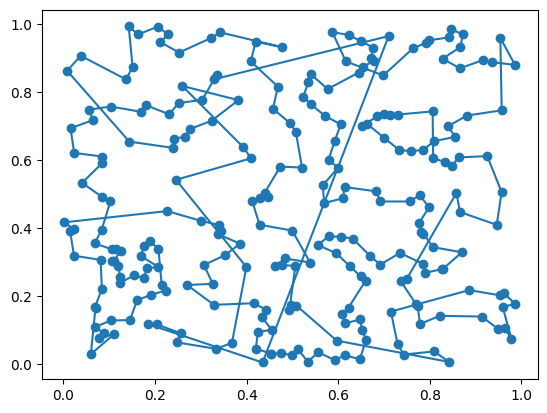

glouton ville 89 : 15.138569937931676


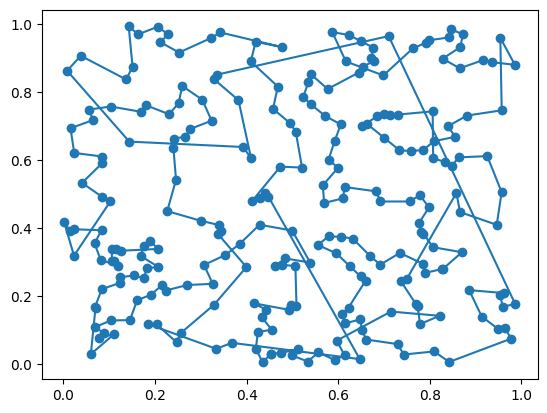

glouton ville 90 : 14.897285474082462


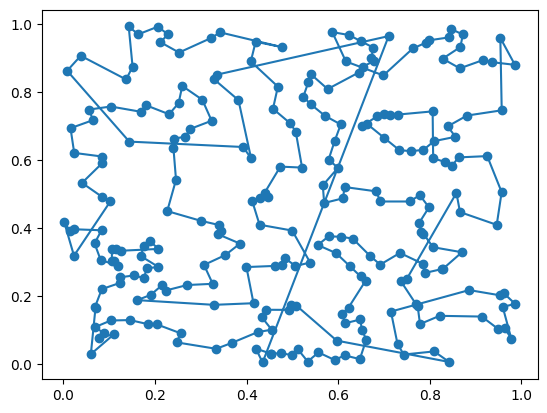

glouton ville 91 : 14.38520182062679


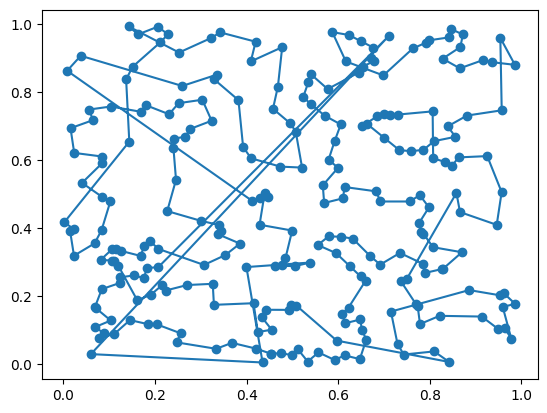

glouton ville 92 : 15.940254922082605


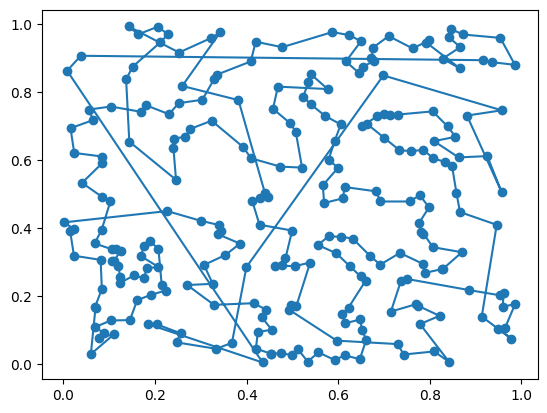

glouton ville 93 : 16.009358093241314


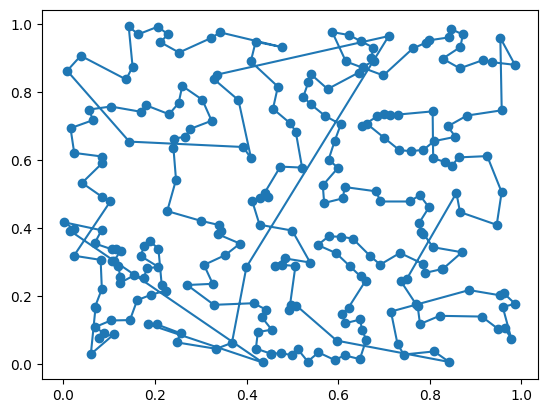

glouton ville 94 : 15.048212715497375


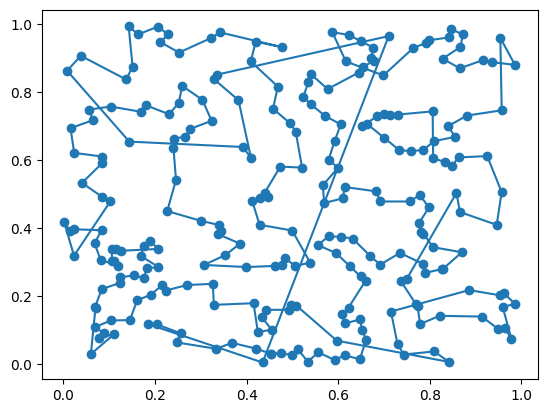

glouton ville 95 : 14.530266670406734


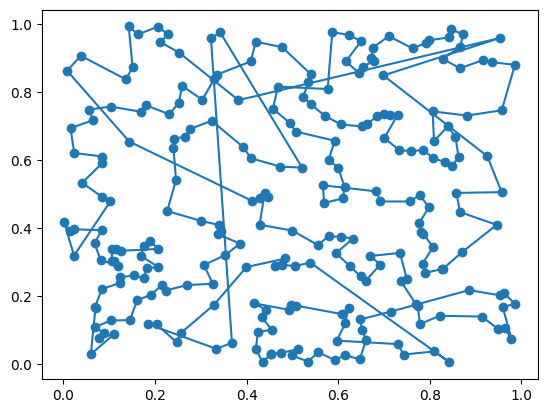

glouton ville 96 : 15.42313838843393


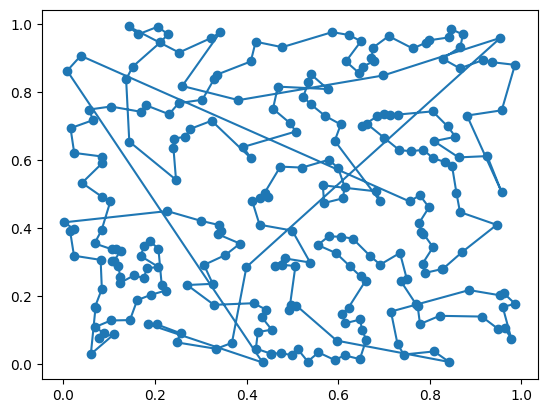

glouton ville 97 : 16.4599603124991


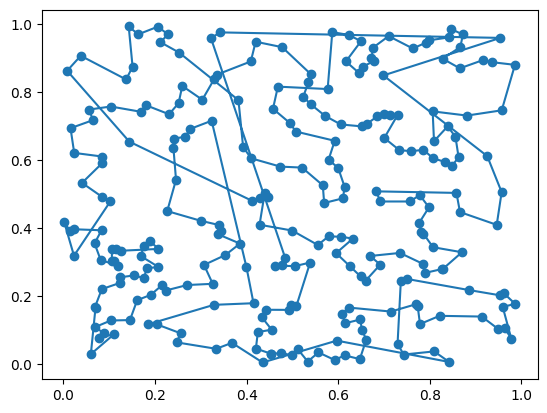

glouton ville 98 : 15.167067330356343


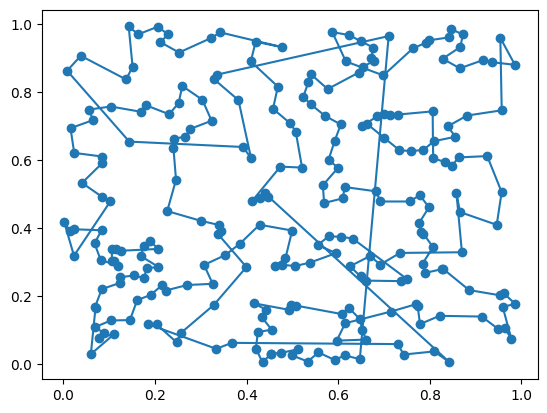

glouton ville 99 : 15.101134853787771


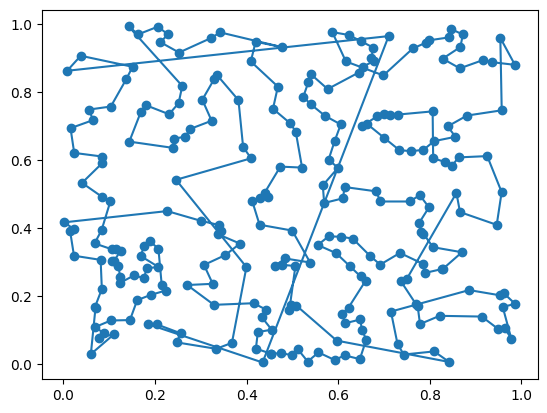

glouton ville 100 : 15.23411966456234


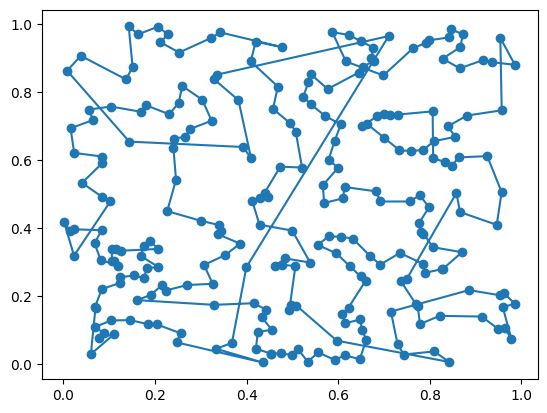

glouton ville 101 : 14.493311803067845


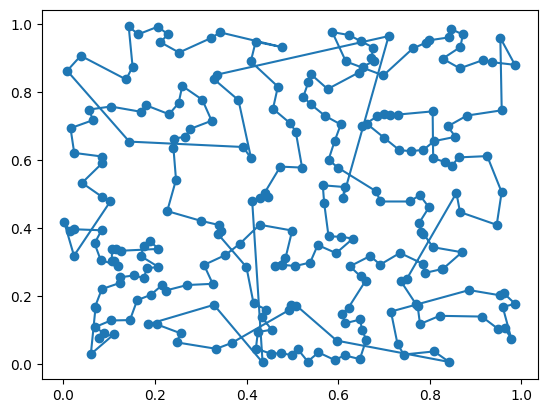

glouton ville 102 : 14.63612352276245


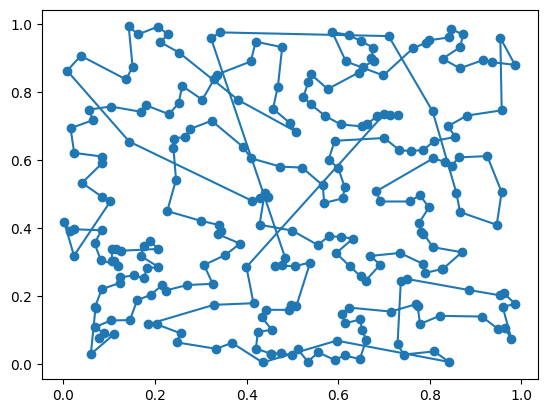

glouton ville 103 : 15.008315747264378


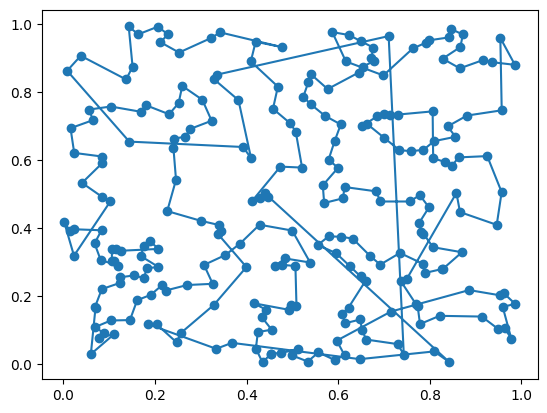

glouton ville 104 : 15.232952490307053


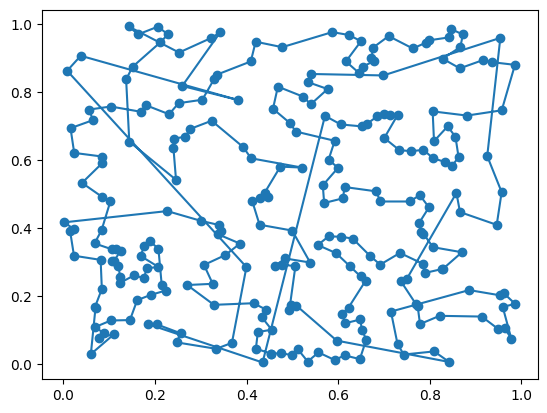

glouton ville 105 : 15.472048165519654


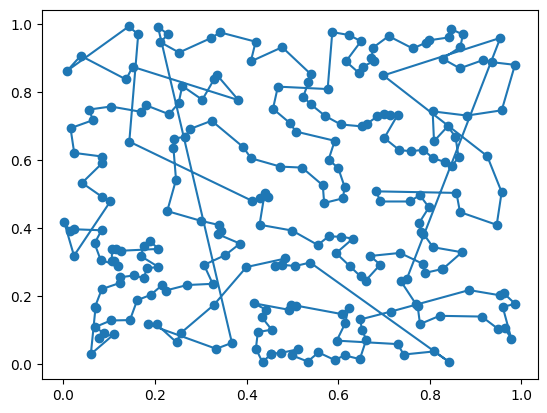

glouton ville 106 : 15.511794808176857


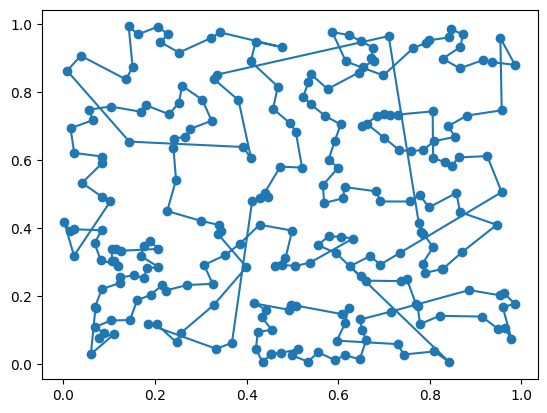

glouton ville 107 : 14.677063656537227


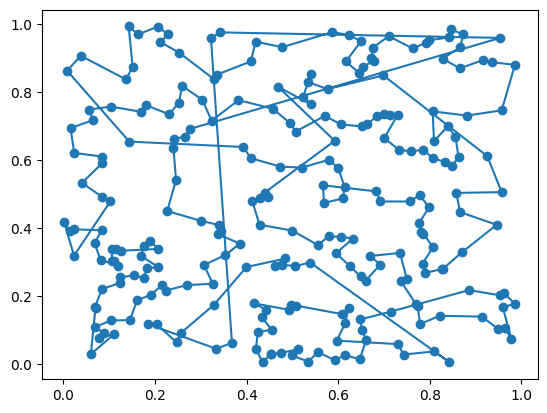

glouton ville 108 : 15.610069362836676


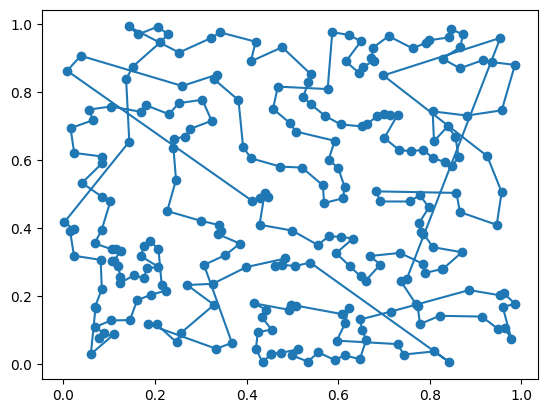

glouton ville 109 : 15.015362782966239


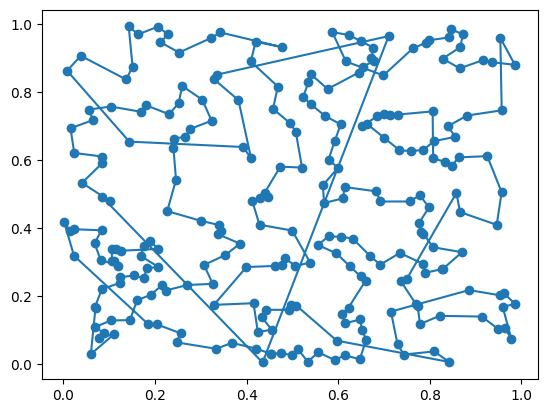

glouton ville 110 : 14.995437719489809


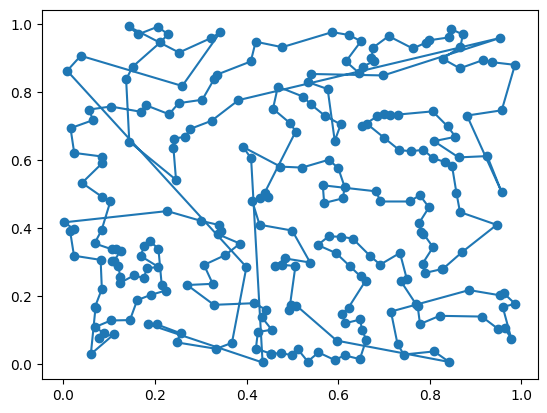

glouton ville 111 : 15.576031249779701


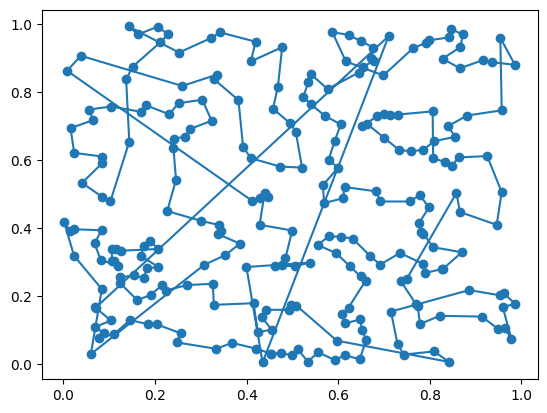

glouton ville 112 : 16.012296004519477


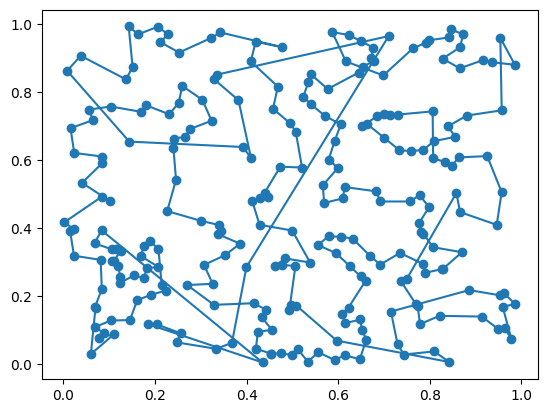

glouton ville 113 : 14.945870884709857


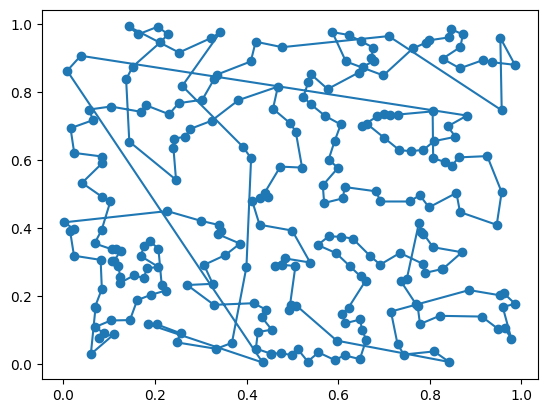

glouton ville 114 : 15.796164610422437


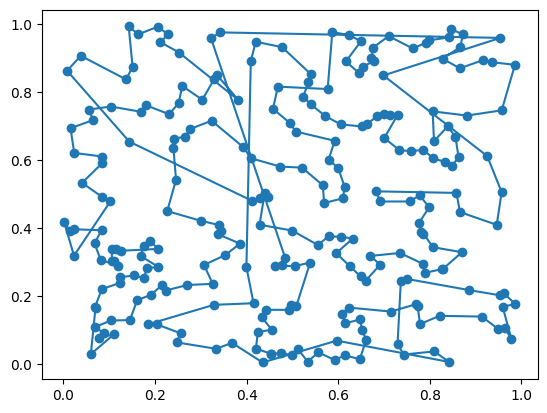

glouton ville 115 : 15.304432650924767


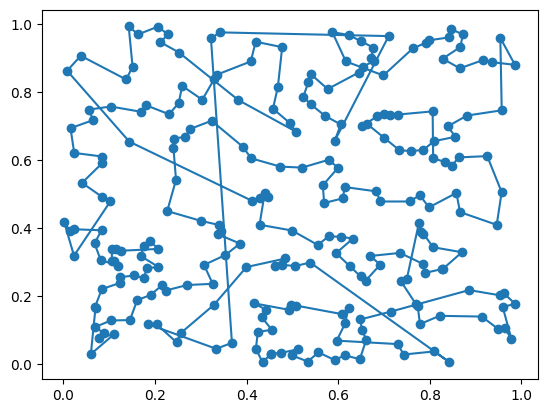

glouton ville 116 : 14.808218843895515


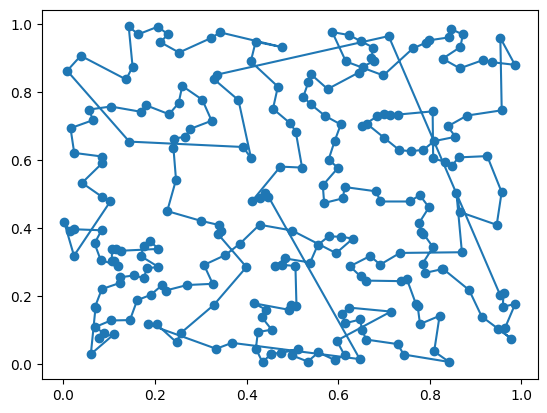

glouton ville 117 : 14.886478773725397


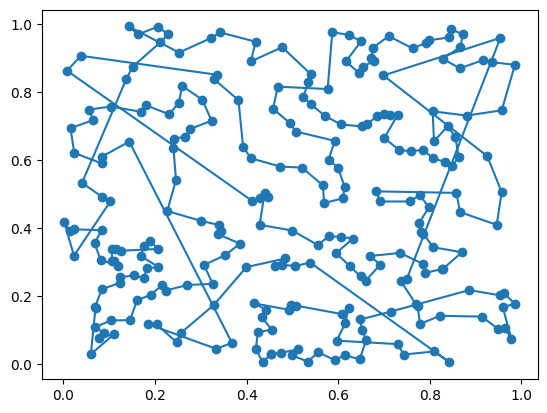

glouton ville 118 : 15.445164740423461


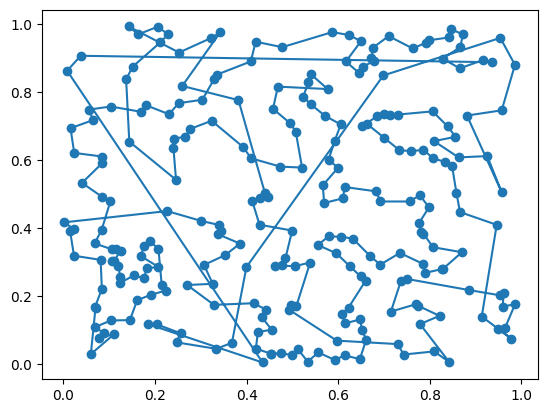

glouton ville 119 : 16.01987711382036


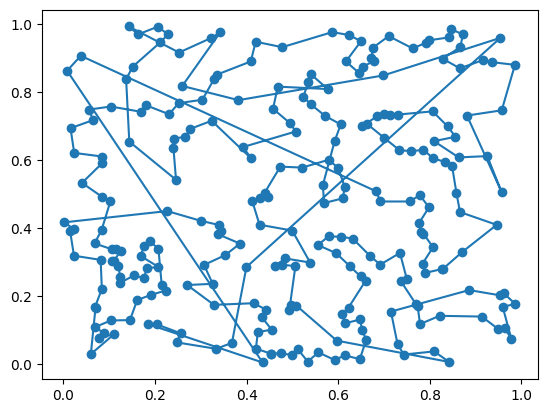

glouton ville 120 : 16.257317927019418


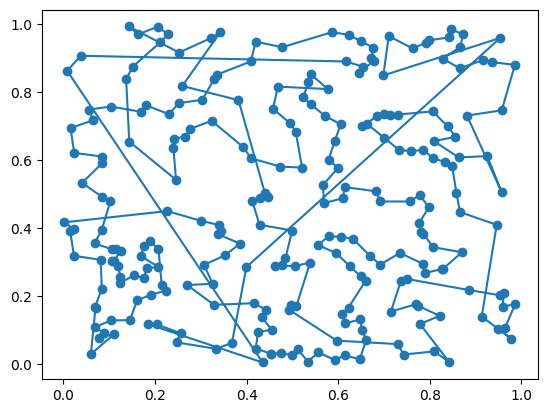

glouton ville 121 : 15.947566760382498


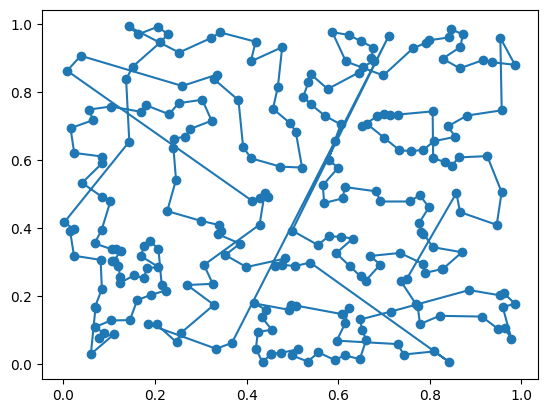

glouton ville 122 : 15.436571114598186


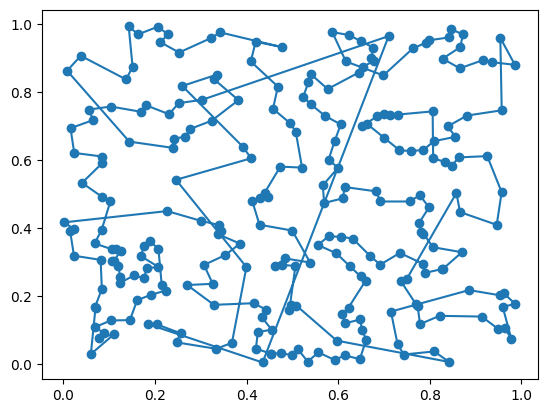

glouton ville 123 : 15.138415043184322


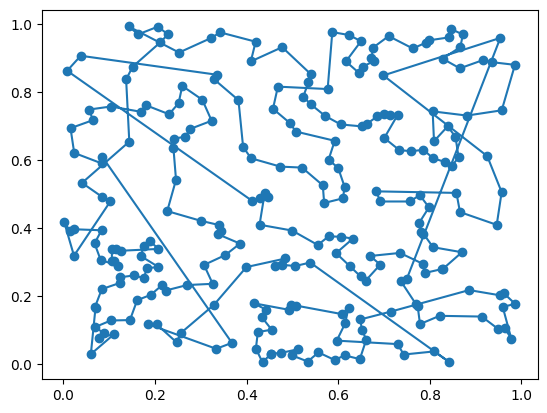

glouton ville 124 : 15.378880568615363


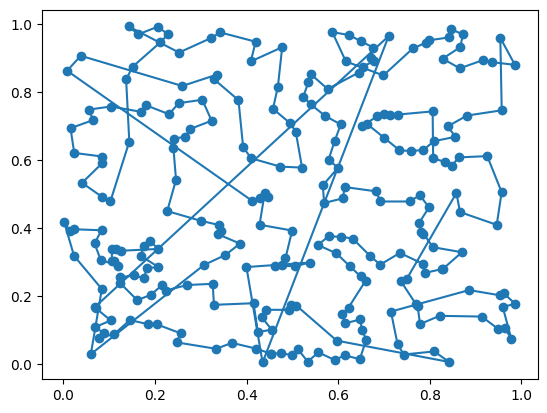

glouton ville 125 : 16.008532546226434


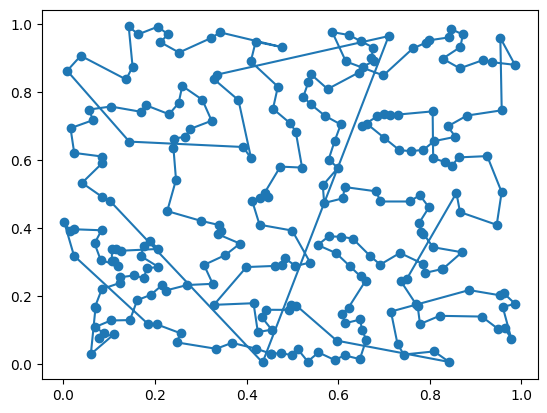

glouton ville 126 : 14.950439797451791


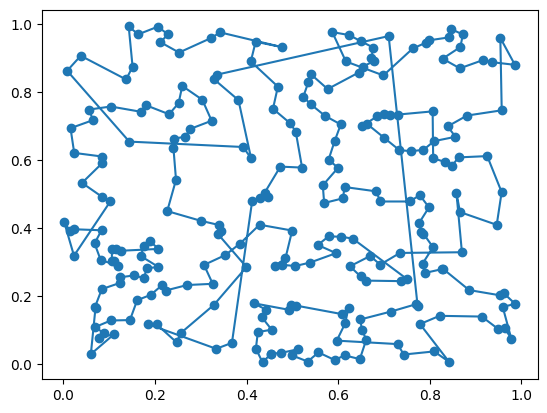

glouton ville 127 : 14.510255083704244


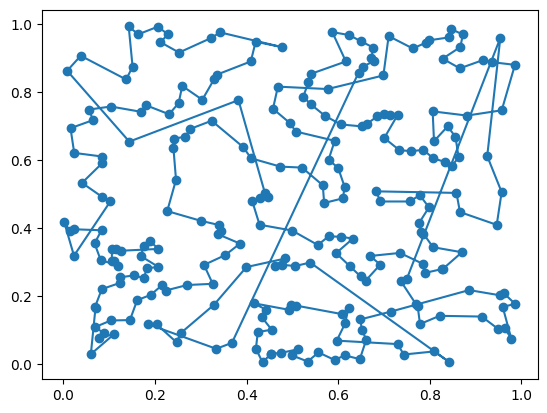

glouton ville 128 : 15.077436336056147


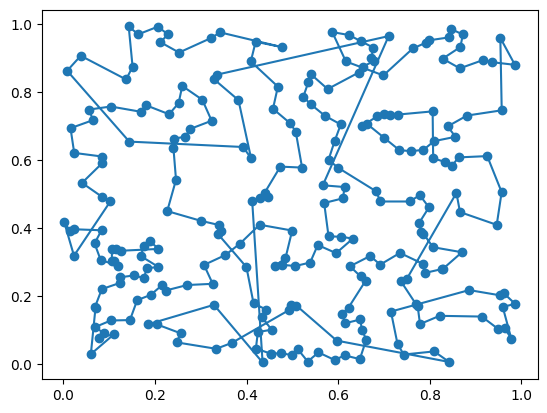

glouton ville 129 : 14.601420716852907


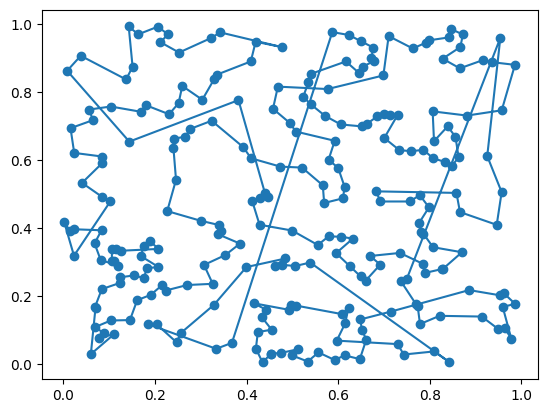

glouton ville 130 : 15.127185695149416


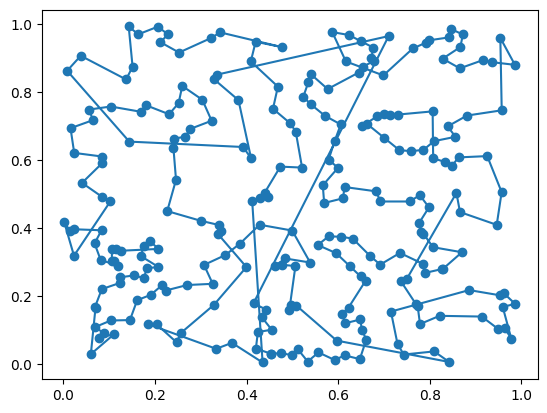

glouton ville 131 : 14.857561452858688


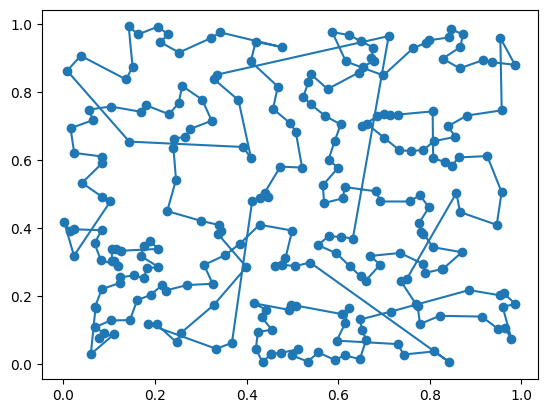

glouton ville 132 : 14.63268469136473


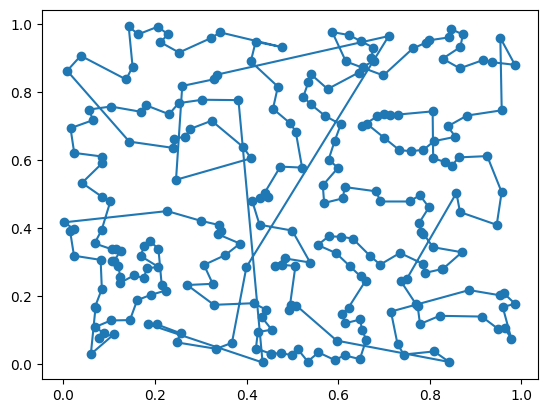

glouton ville 133 : 15.36424545760502


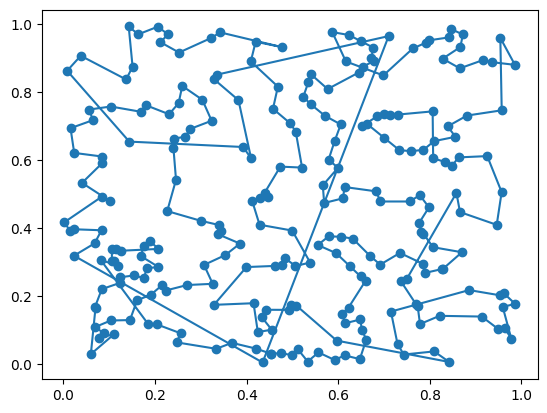

glouton ville 134 : 14.888642964706685


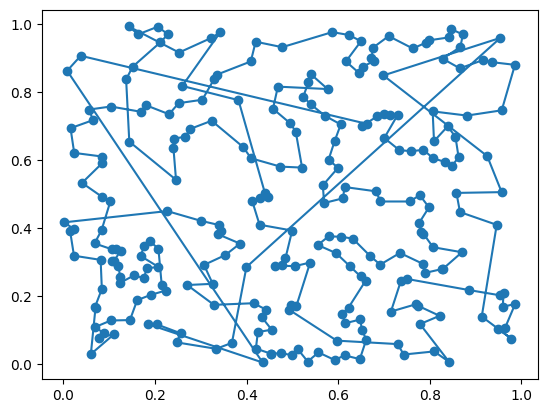

glouton ville 135 : 16.094740070047322


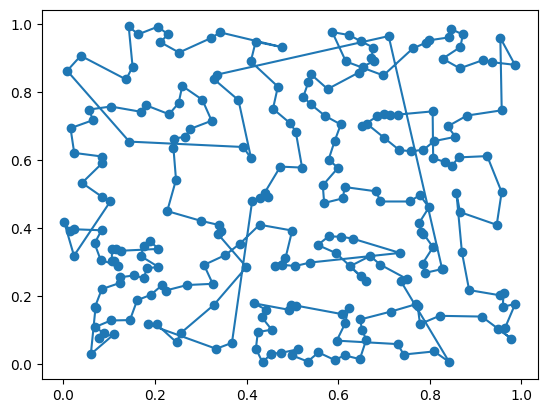

glouton ville 136 : 14.640636675299238


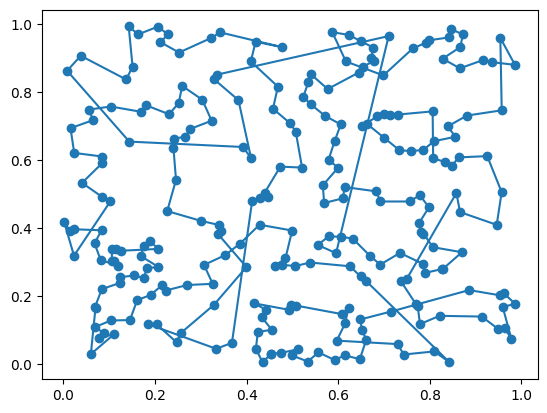

glouton ville 137 : 14.594365501967863


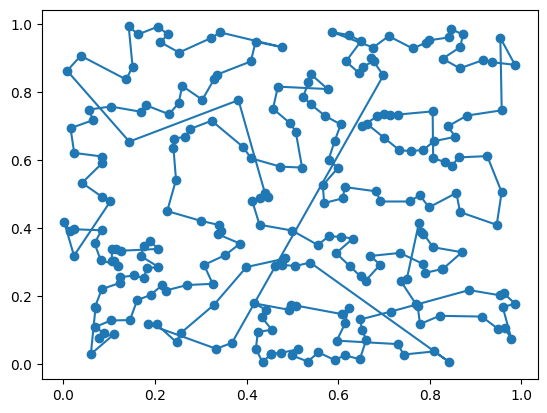

glouton ville 138 : 14.188724207823128


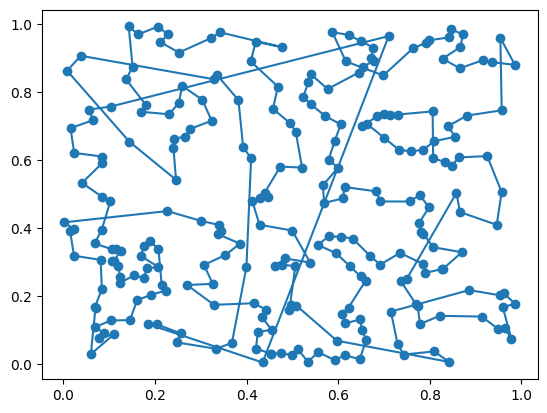

glouton ville 139 : 15.405877355624423


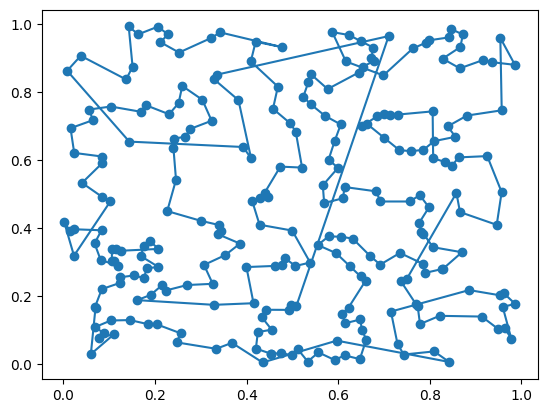

glouton ville 140 : 14.272766321713366


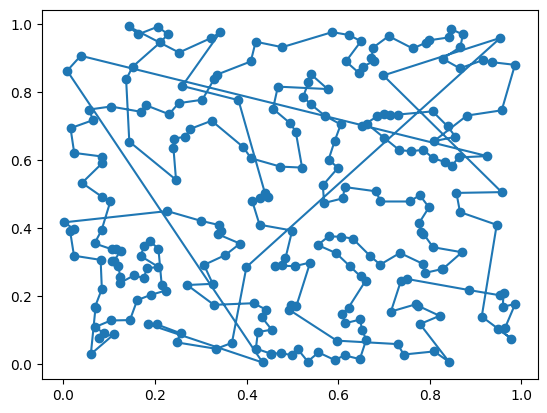

glouton ville 141 : 16.415386277716507


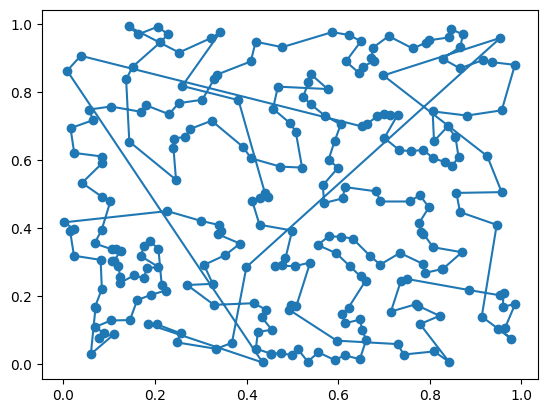

glouton ville 142 : 16.072135552072794


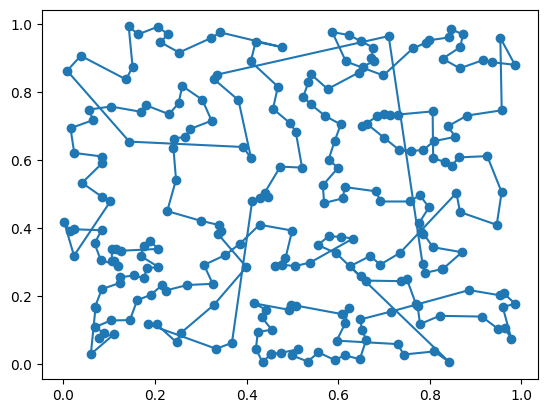

glouton ville 143 : 14.701398207792641


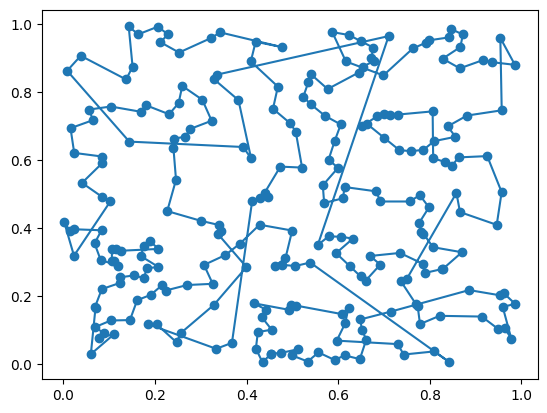

glouton ville 144 : 14.674772457523904


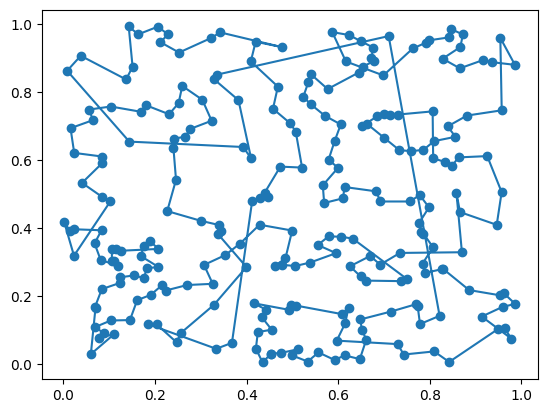

glouton ville 145 : 14.523016007191778


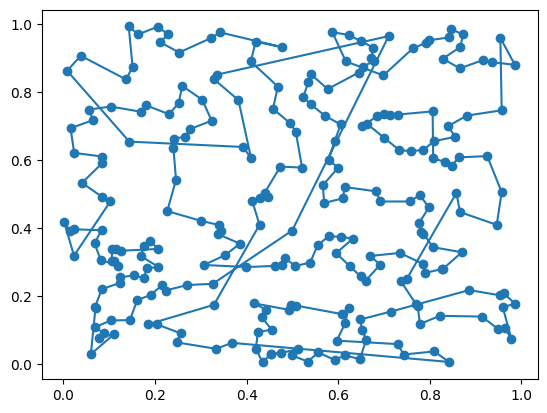

glouton ville 146 : 14.52738570153164


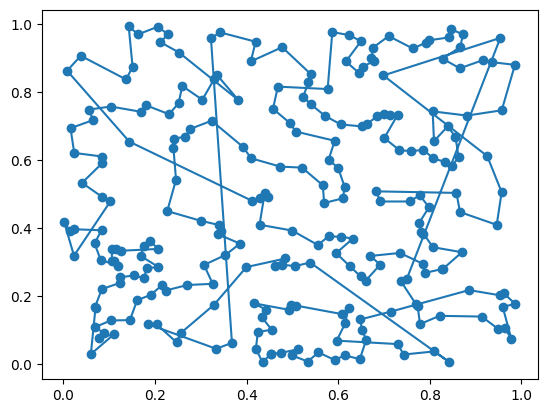

glouton ville 147 : 15.236466664265661


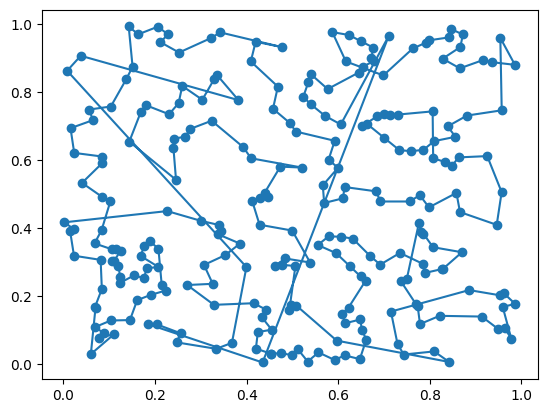

glouton ville 148 : 15.251996774246544


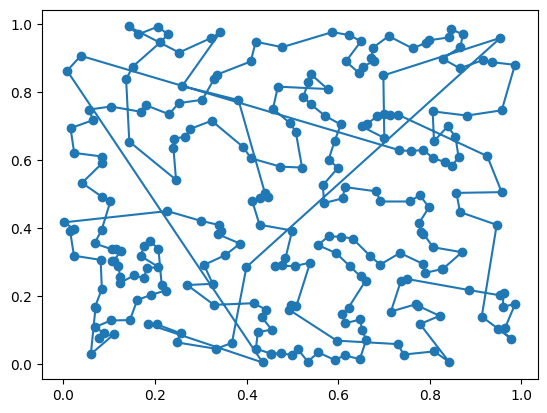

glouton ville 149 : 16.196362780902085


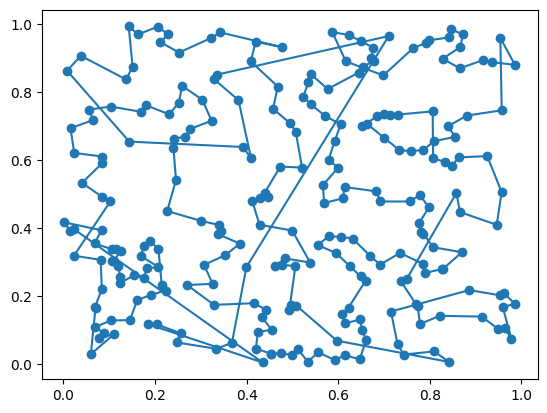

glouton ville 150 : 15.042792763807313


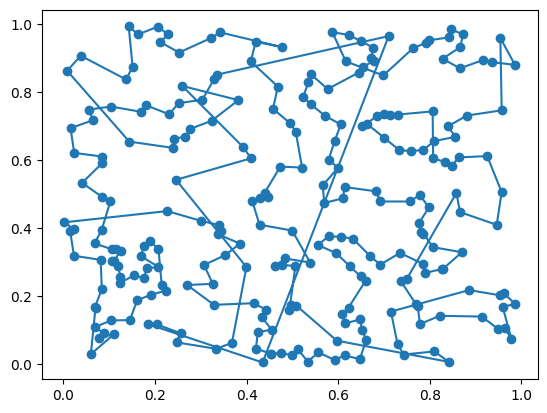

glouton ville 151 : 15.114252588535797


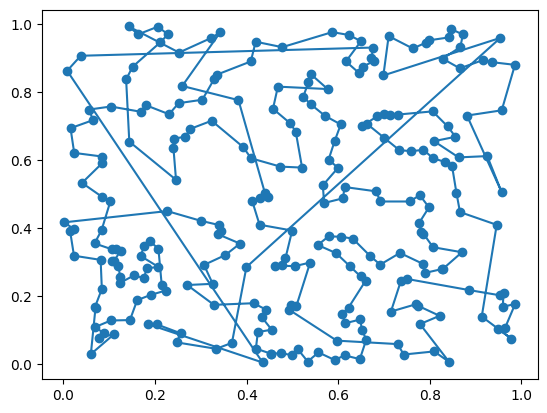

glouton ville 152 : 16.027241513242256


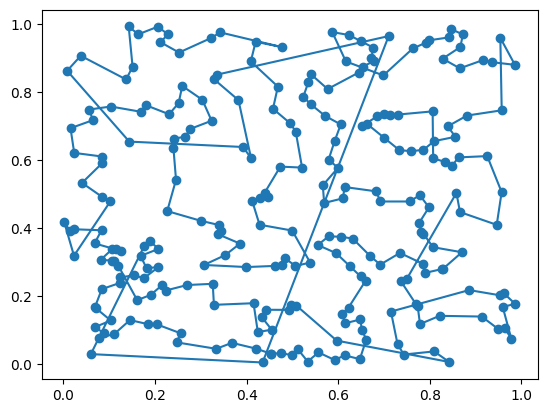

glouton ville 153 : 14.839164977199427


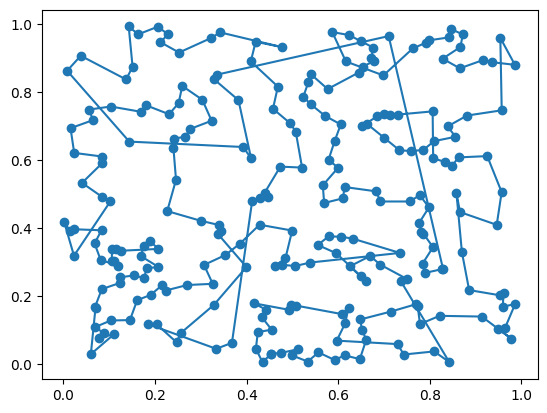

glouton ville 154 : 14.638150762245735


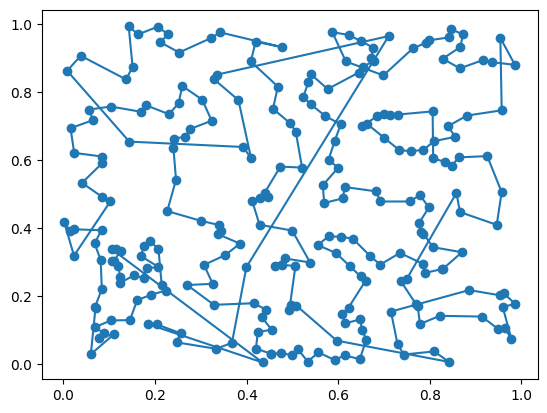

glouton ville 155 : 14.966950225862016


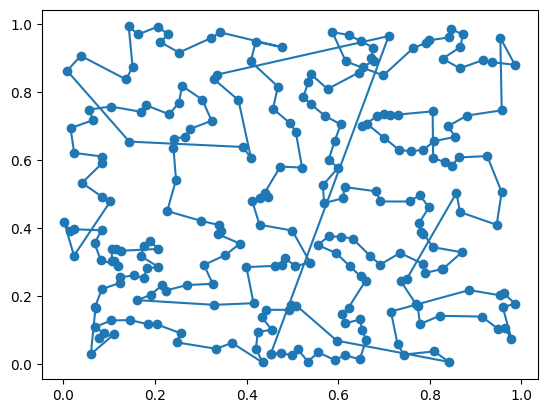

glouton ville 156 : 14.391786811591432


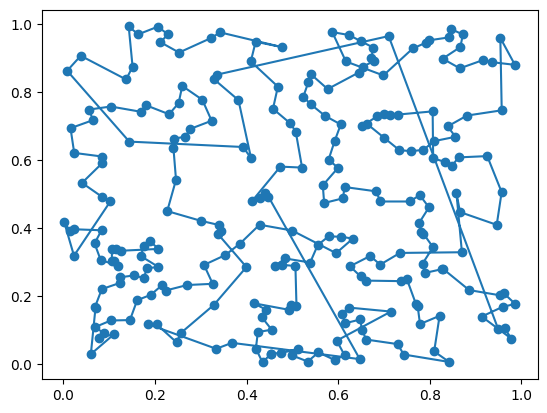

glouton ville 157 : 14.9387543381382


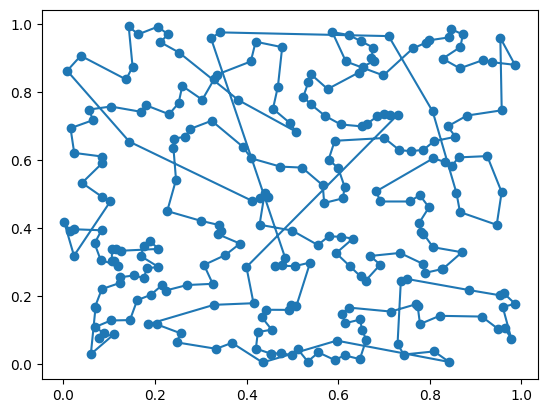

glouton ville 158 : 14.995650551547245


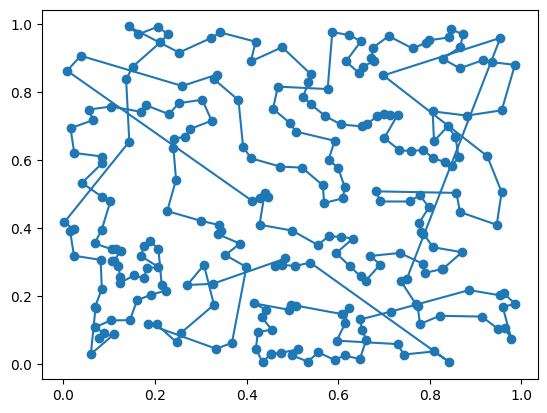

glouton ville 159 : 15.110701410392968


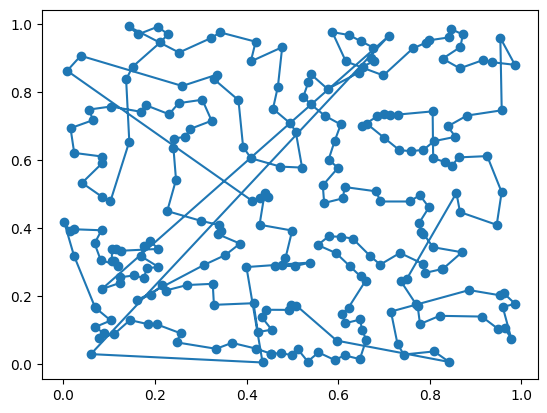

glouton ville 160 : 16.124049758611687


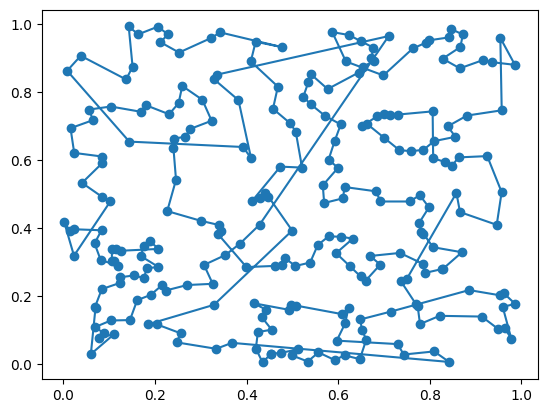

glouton ville 161 : 14.499802660093668


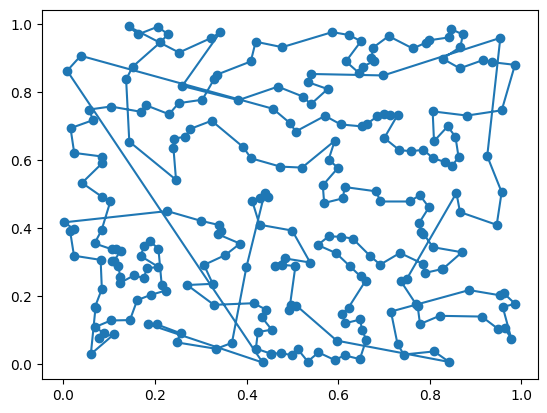

glouton ville 162 : 15.29228581431551


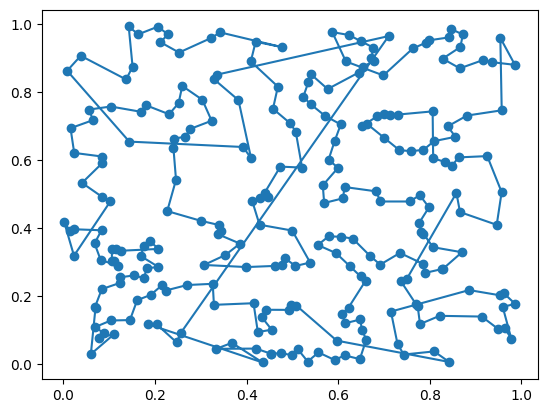

glouton ville 163 : 14.558637510667001


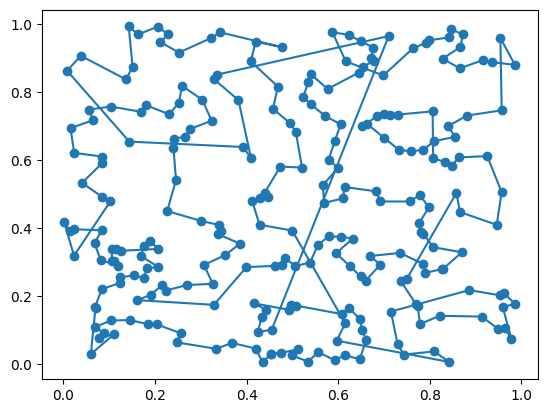

glouton ville 164 : 14.463177526261699


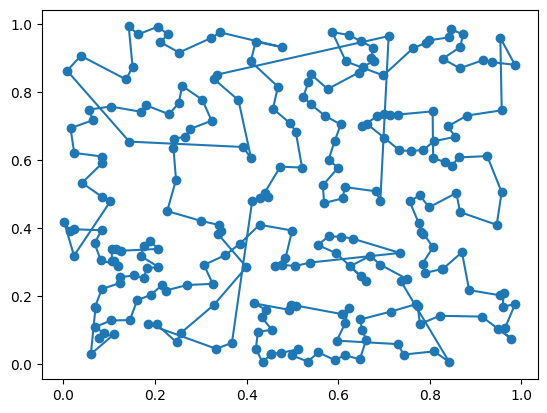

glouton ville 165 : 14.344439483644095


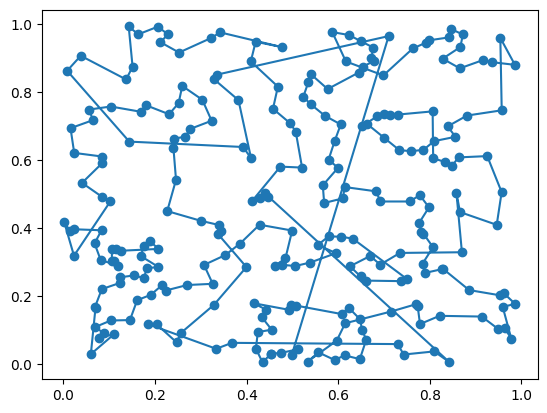

glouton ville 166 : 15.154527147921046


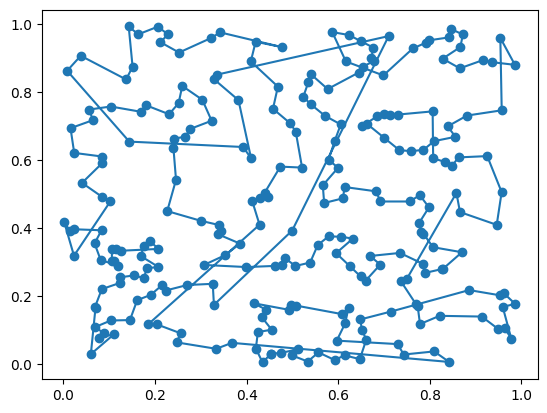

glouton ville 167 : 14.602993750272445


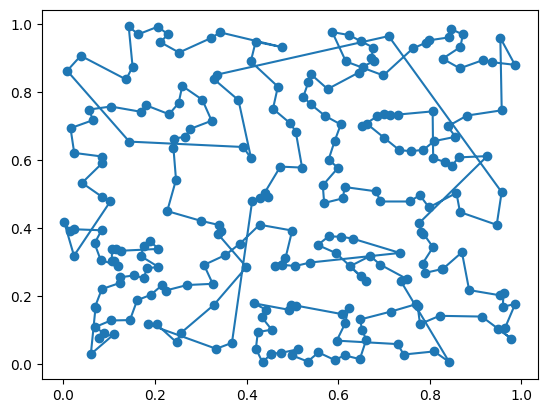

glouton ville 168 : 14.512945430209314


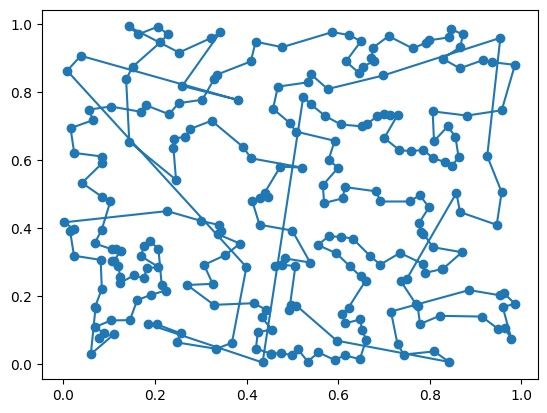

glouton ville 169 : 15.493626683812275


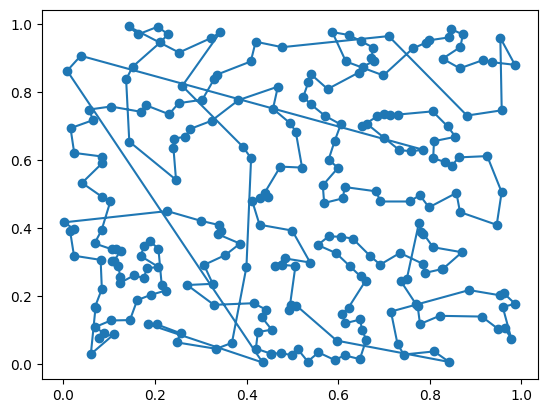

glouton ville 170 : 15.650271511116493


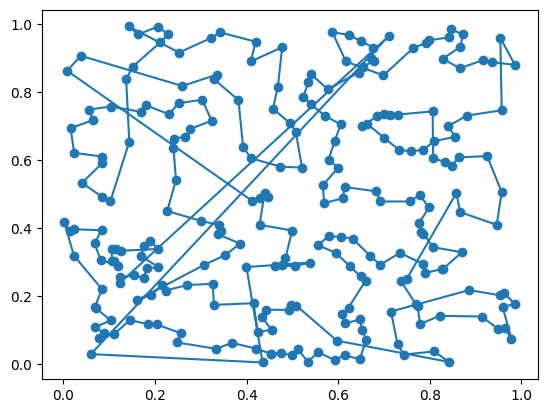

glouton ville 171 : 16.05392558231116


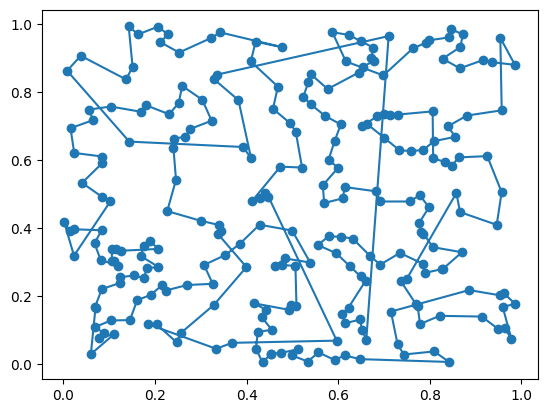

glouton ville 172 : 14.926150356492572


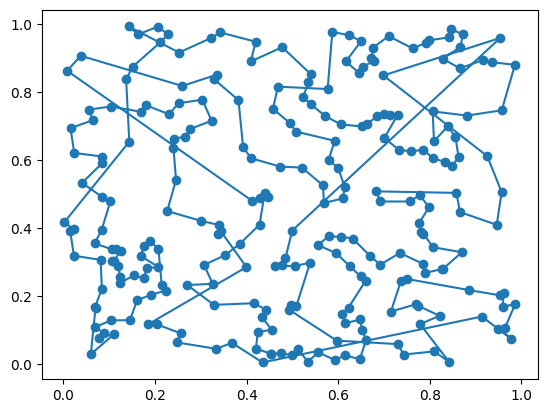

glouton ville 173 : 15.162211852259956


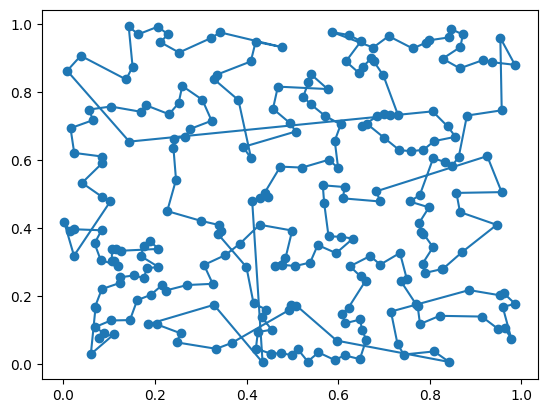

glouton ville 174 : 14.419768928804823


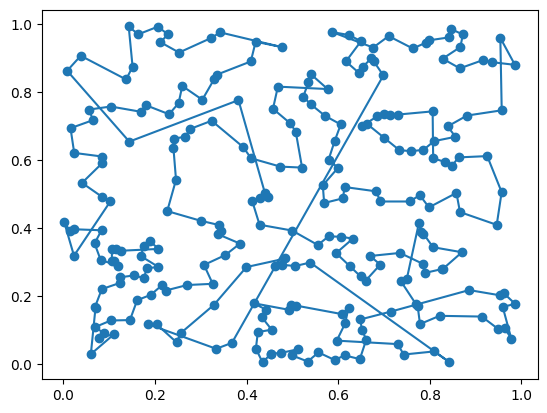

glouton ville 175 : 14.18142927804241


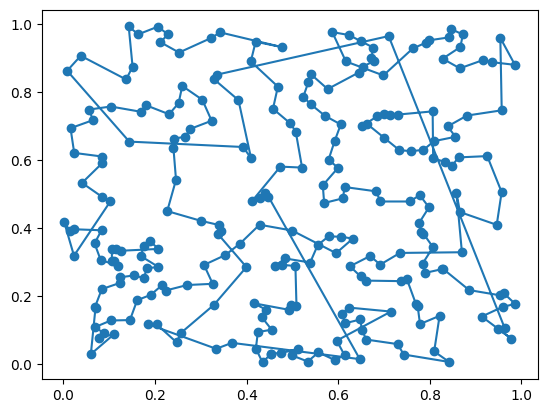

glouton ville 176 : 14.94837069710848


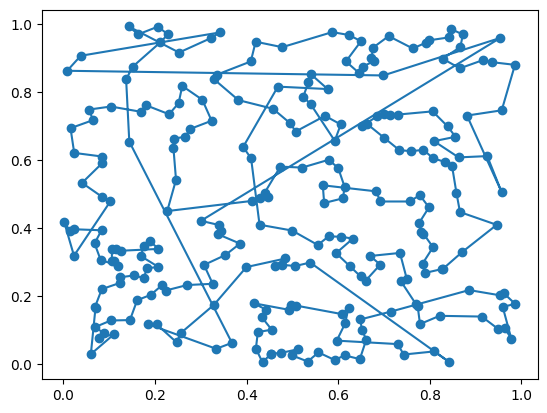

glouton ville 177 : 15.698558584224653


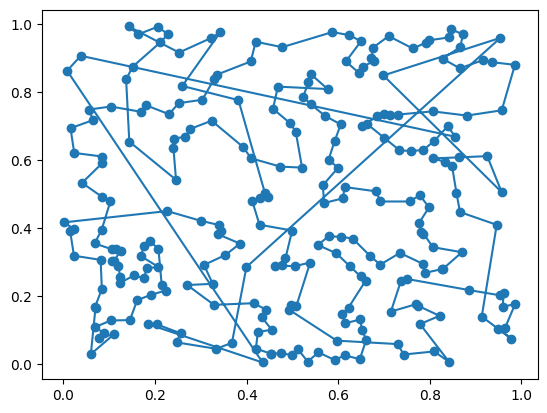

glouton ville 178 : 16.374208581452866


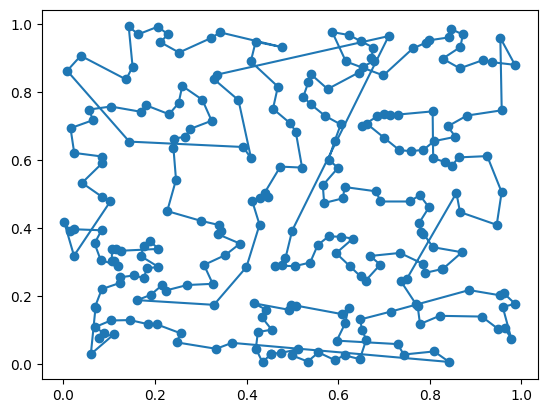

glouton ville 179 : 14.29454871471764


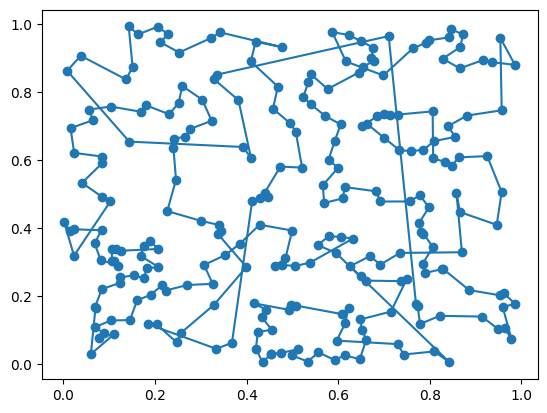

glouton ville 180 : 14.765827776136865


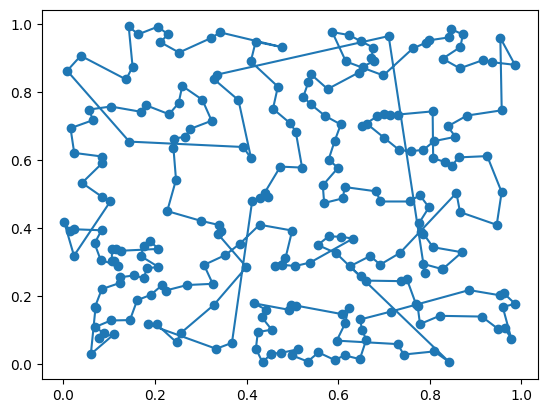

glouton ville 181 : 14.735204844214023


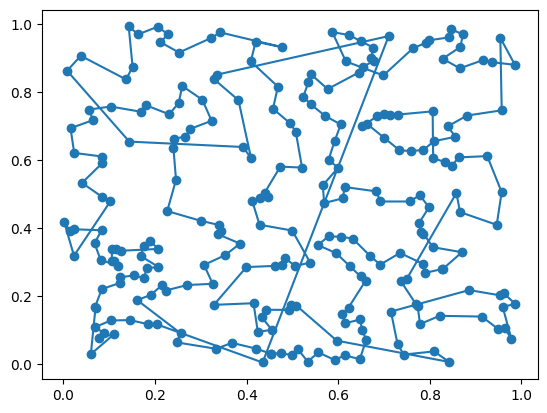

glouton ville 182 : 14.607740860299092


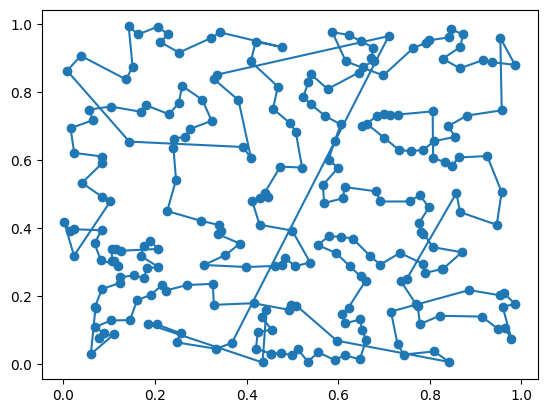

glouton ville 183 : 14.590806413655232


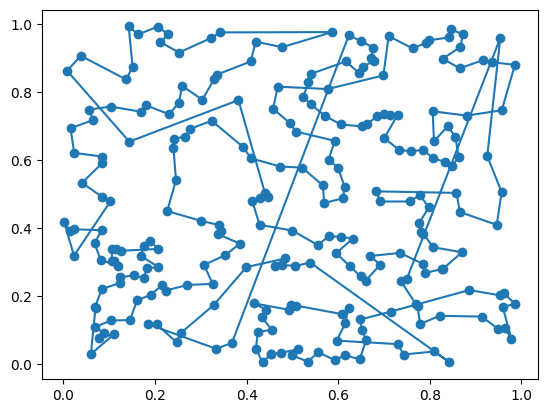

glouton ville 184 : 15.311401980255571


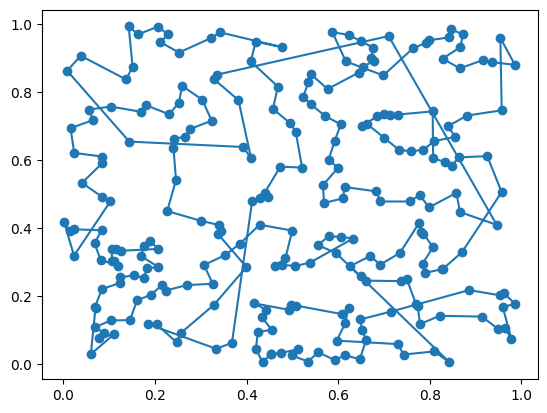

glouton ville 185 : 14.6225762575029


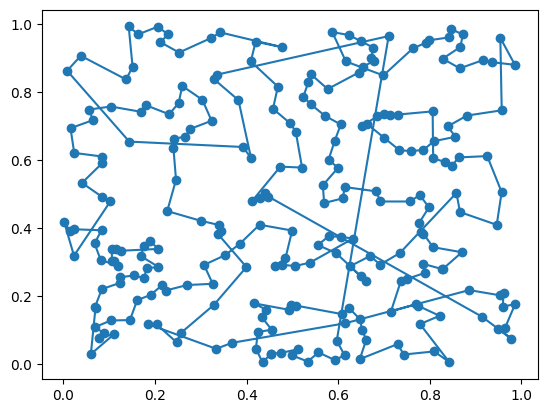

glouton ville 186 : 15.145209104571288


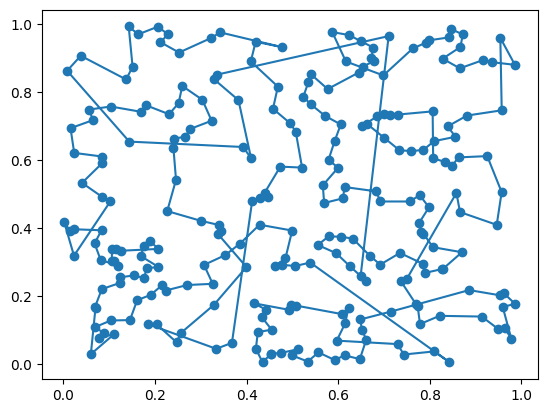

glouton ville 187 : 14.753789557983508


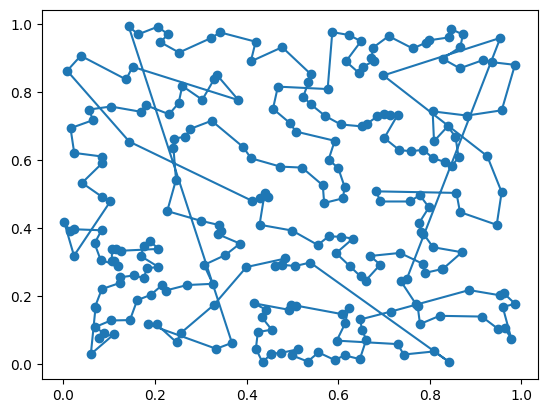

glouton ville 188 : 15.319622947853139


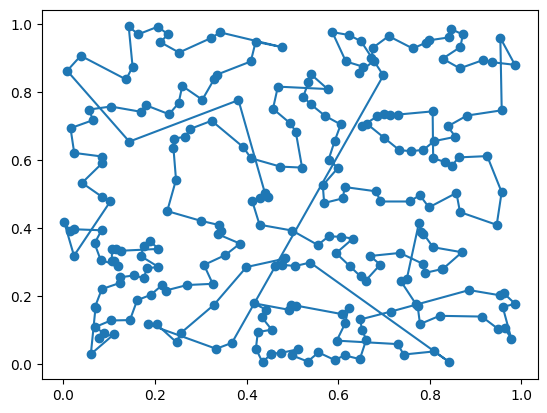

glouton ville 189 : 14.21425013845005


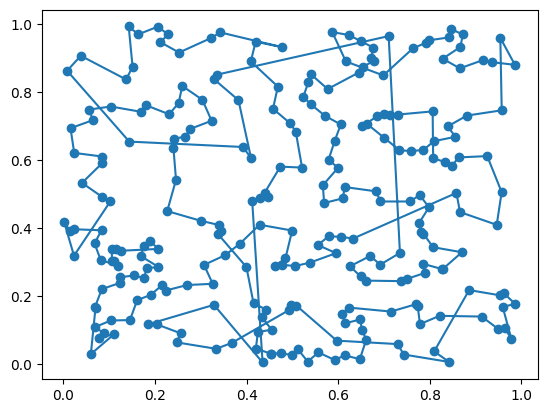

glouton ville 190 : 14.569612721717444


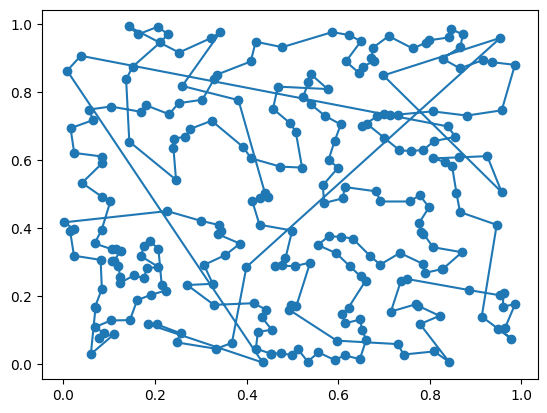

glouton ville 191 : 16.345648211554472


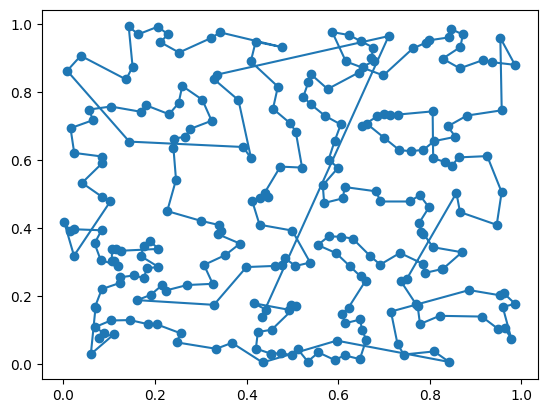

glouton ville 192 : 14.374043700279667


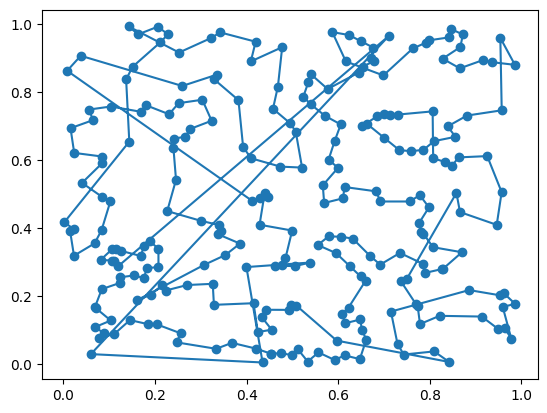

glouton ville 193 : 16.006211195233853


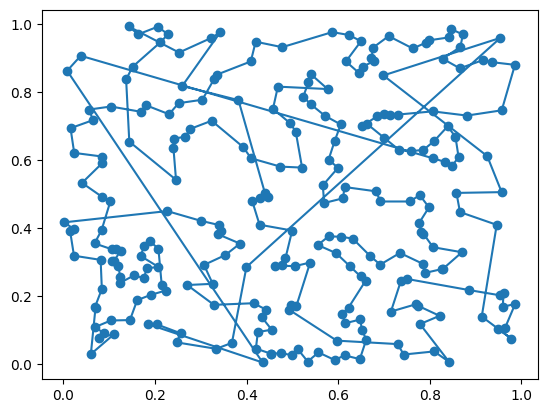

glouton ville 194 : 16.23665872076944


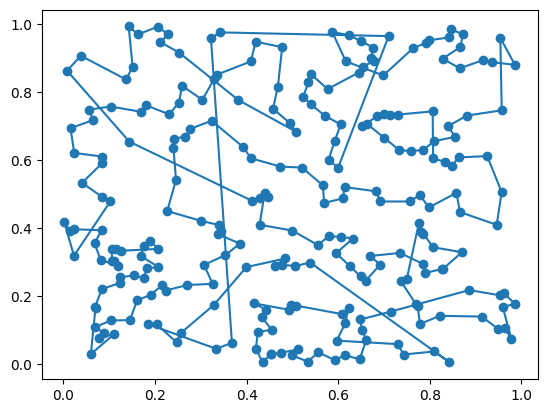

glouton ville 195 : 14.883861844496439


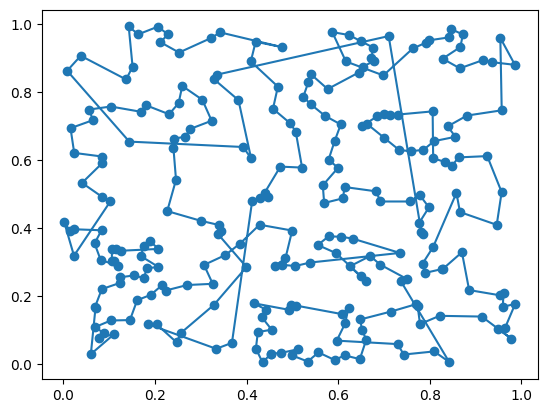

glouton ville 196 : 14.541921498060573


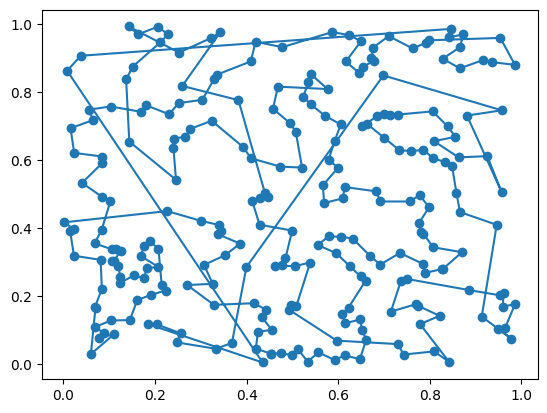

glouton ville 197 : 15.957985437574418


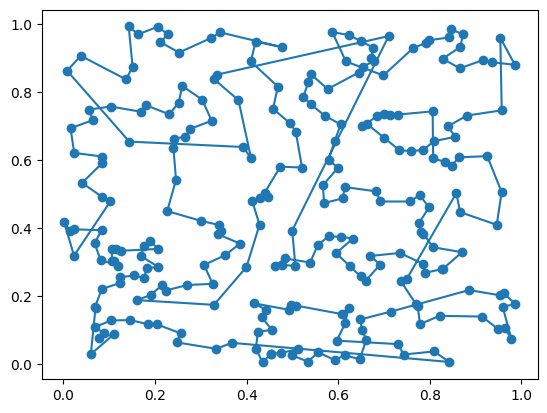

glouton ville 198 : 14.333586291266391


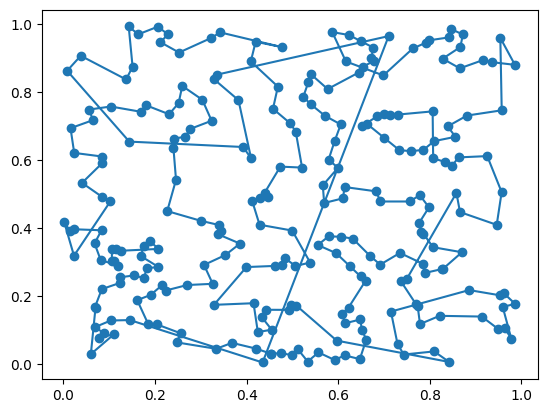

glouton ville 199 : 14.621576720669038


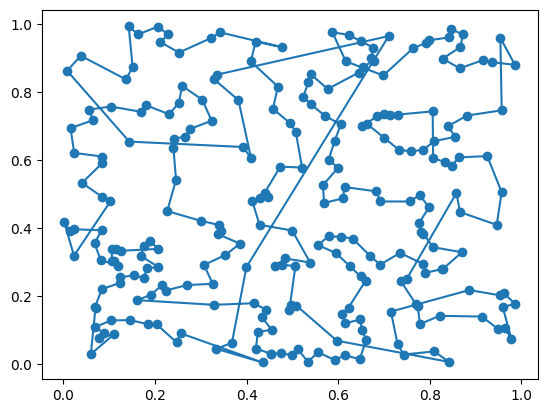

glouton ville 200 : 14.505452563571746


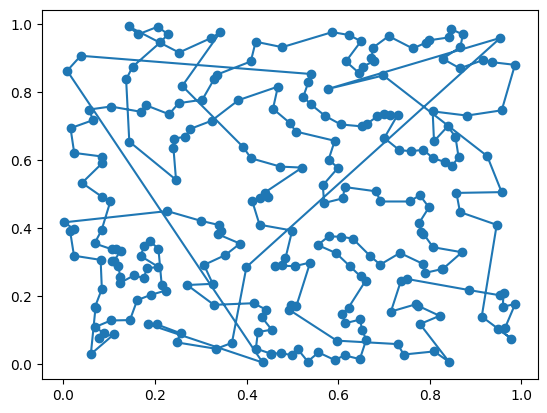

glouton ville 201 : 15.998816526501678


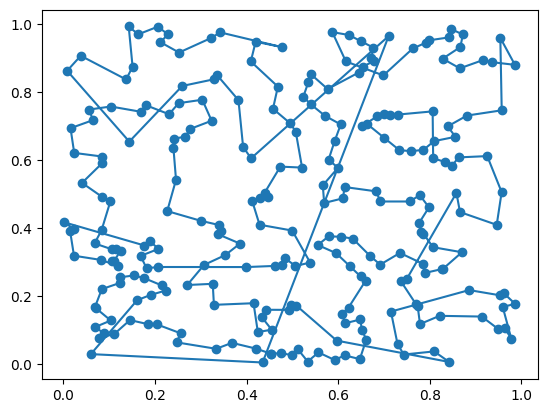

glouton ville 202 : 14.776773913562744


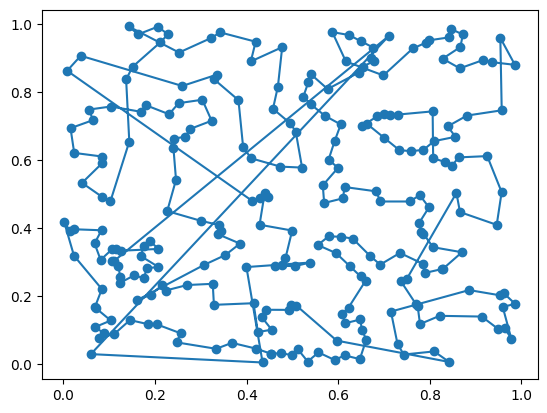

glouton ville 203 : 16.02163159192421


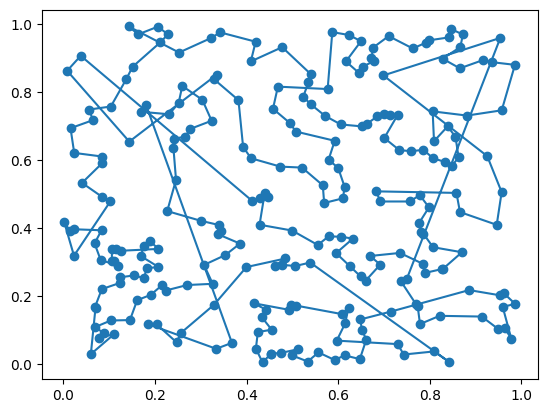

glouton ville 204 : 15.463859524898812


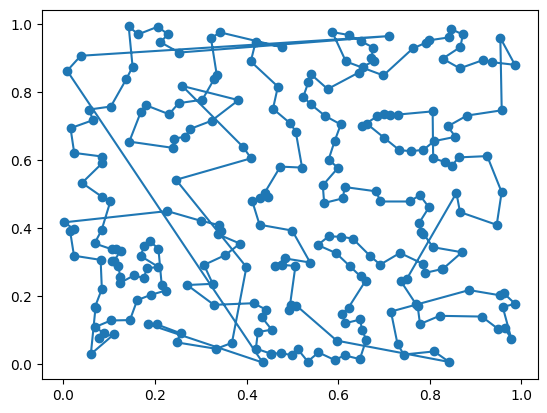

glouton ville 205 : 15.584142199053355


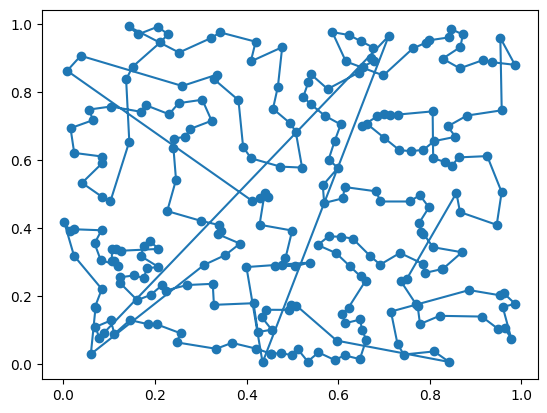

glouton ville 206 : 16.020115917089385


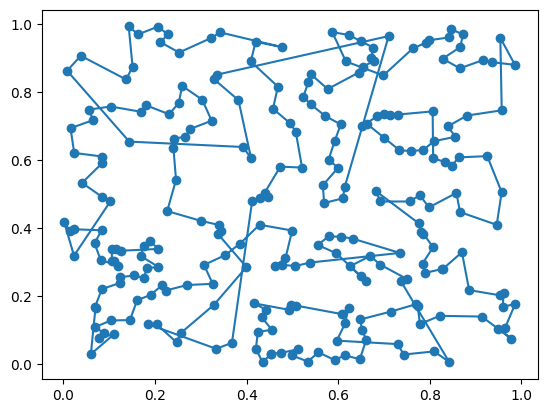

glouton ville 207 : 14.37120589325761


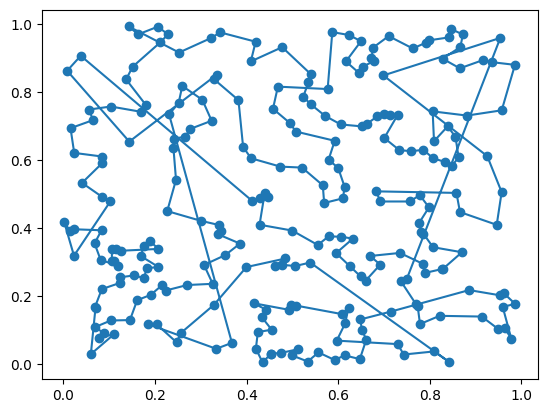

glouton ville 208 : 15.433883869704621


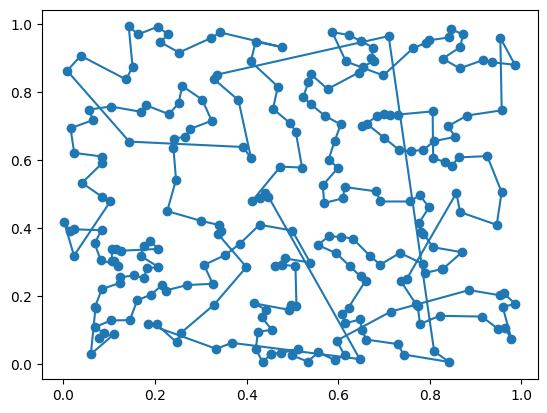

glouton ville 209 : 15.057704985045786


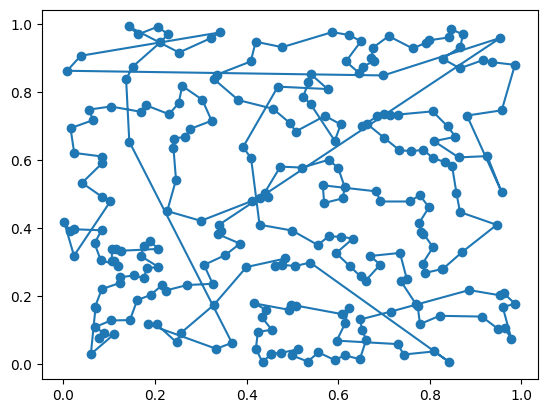

glouton ville 210 : 15.653265910518204


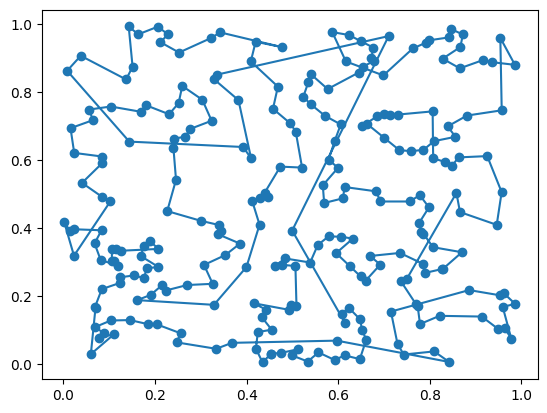

glouton ville 211 : 14.406682609005015


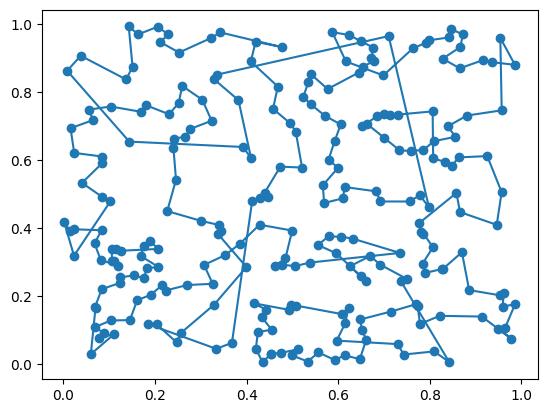

glouton ville 212 : 14.413794980860692


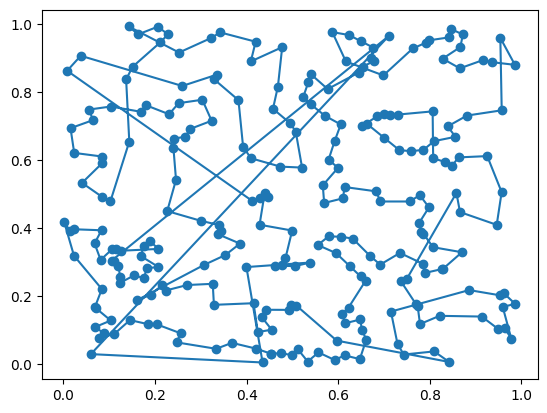

glouton ville 213 : 16.020173482656077


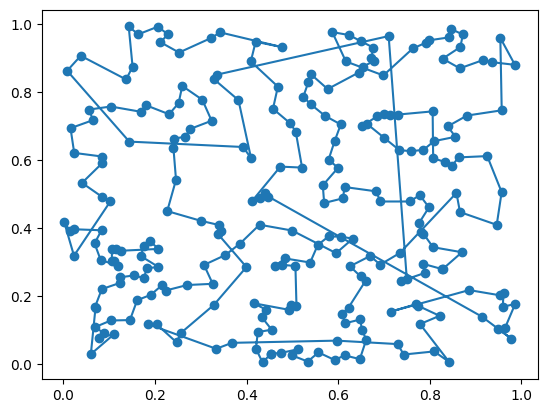

glouton ville 214 : 14.797715191597977


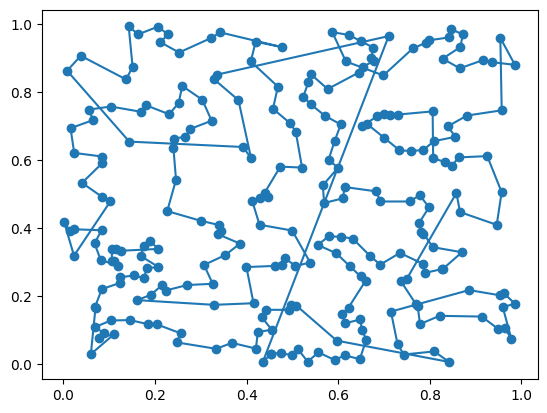

glouton ville 215 : 14.374945077005956


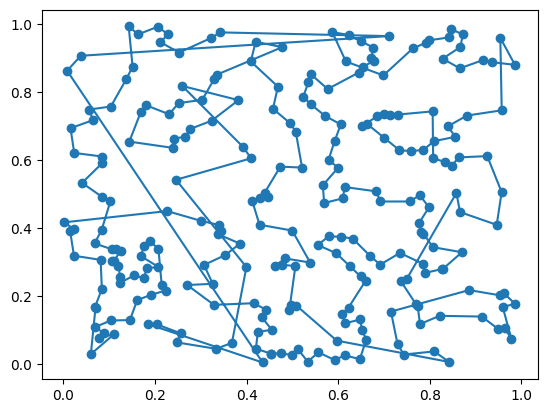

glouton ville 216 : 15.487240738148706


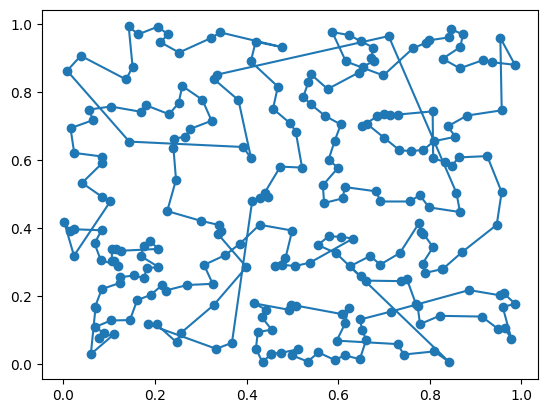

glouton ville 217 : 14.42167172768914


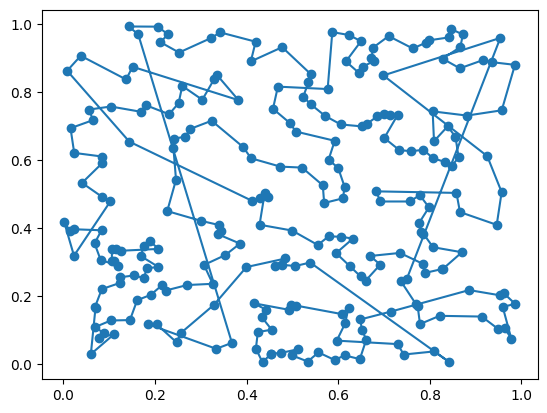

glouton ville 218 : 15.307678268313593


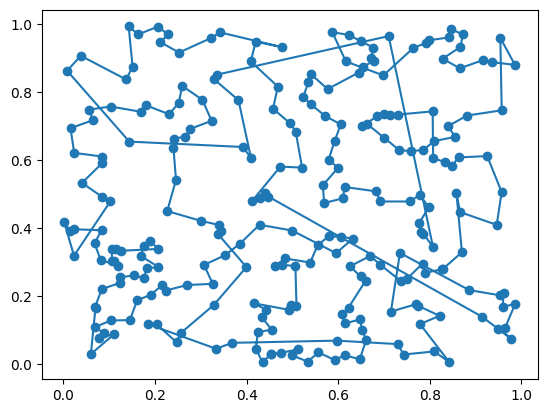

glouton ville 219 : 14.78716286297818


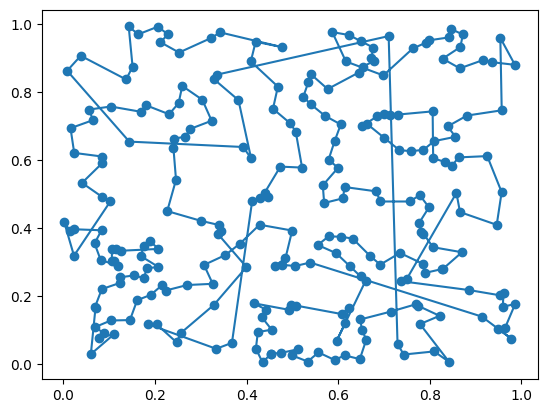

glouton ville 220 : 14.99155292553447


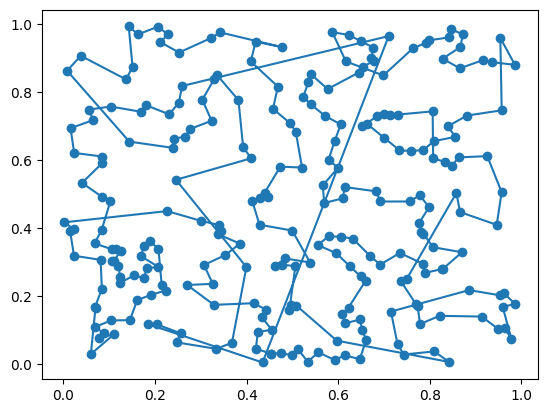

glouton ville 221 : 15.048927298897228


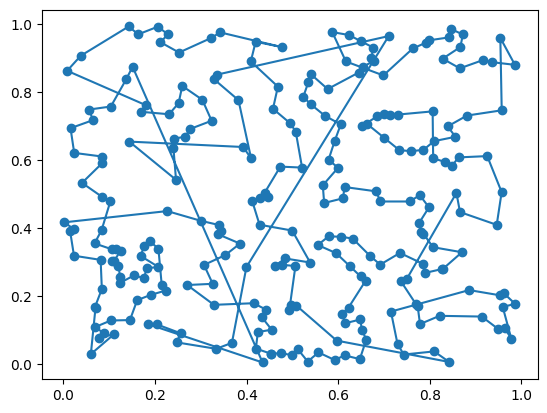

glouton ville 222 : 15.444739421959406


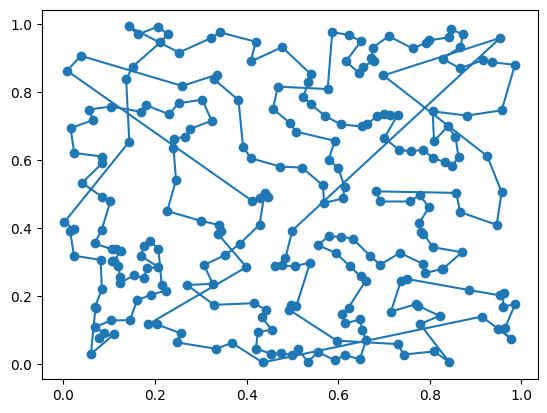

glouton ville 223 : 15.146778451689427


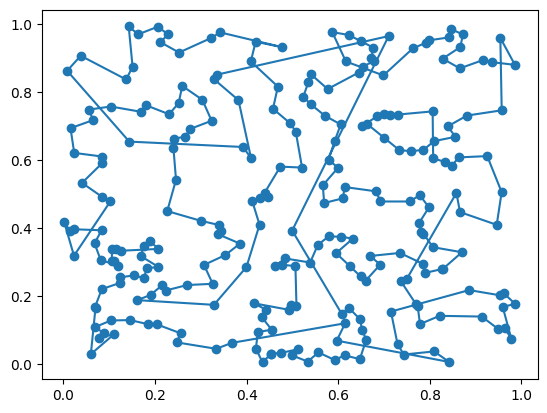

glouton ville 224 : 14.43054744944537


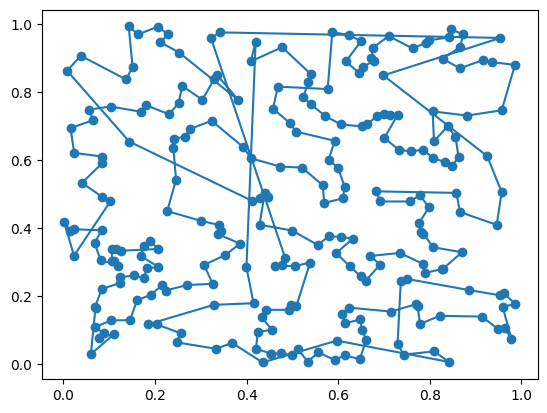

glouton ville 225 : 15.382873470766258


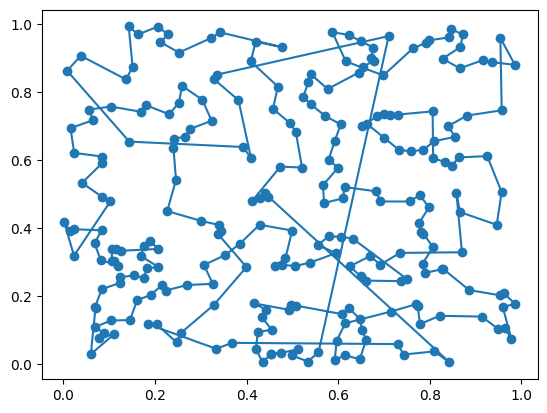

glouton ville 226 : 15.101693825083077


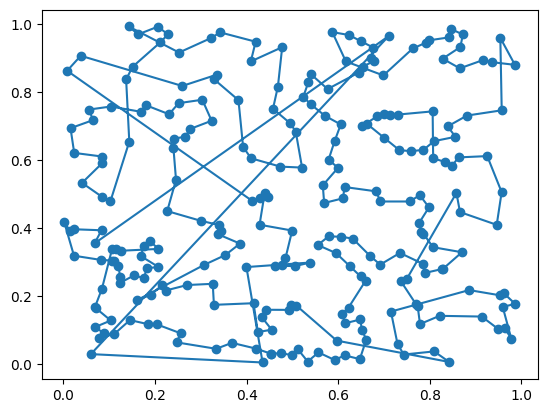

glouton ville 227 : 16.00818439076736


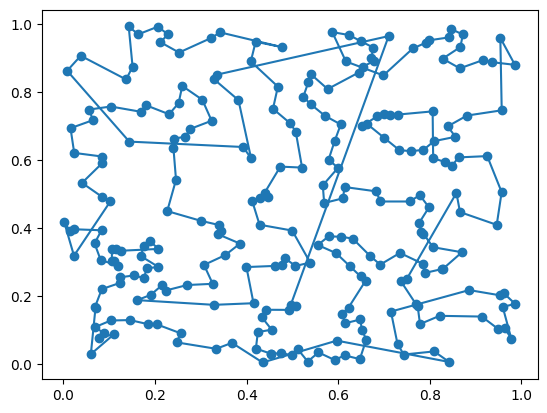

glouton ville 228 : 14.280725888964351


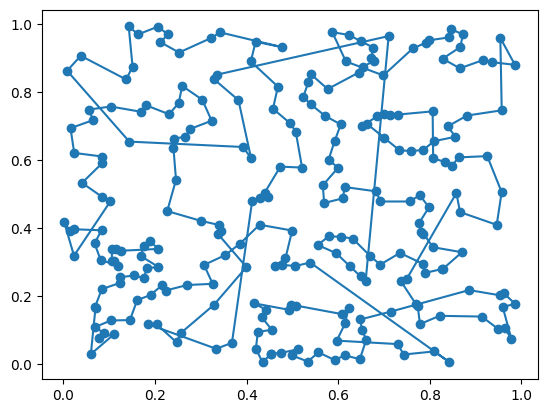

glouton ville 229 : 14.748574057290371


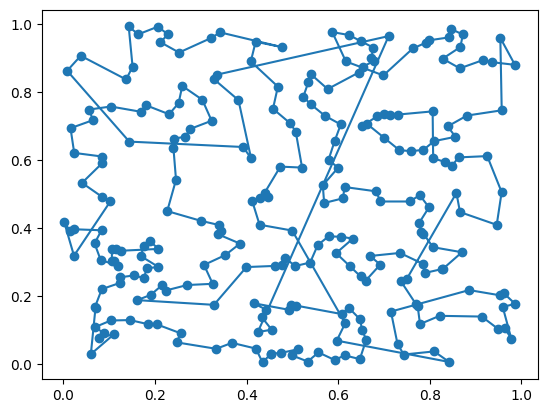

glouton ville 230 : 14.477078684684102


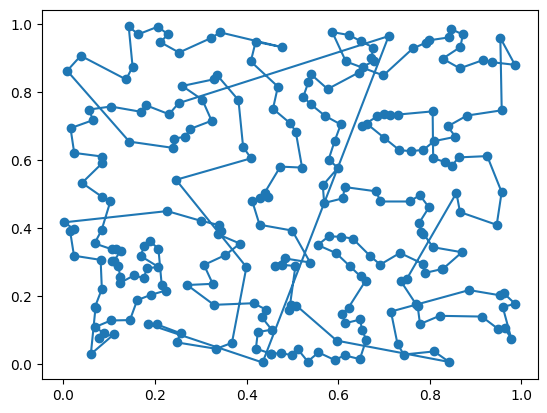

glouton ville 231 : 15.089401224763249


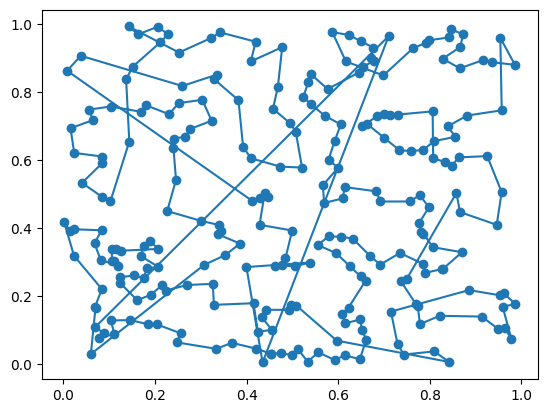

glouton ville 232 : 15.993425874456744


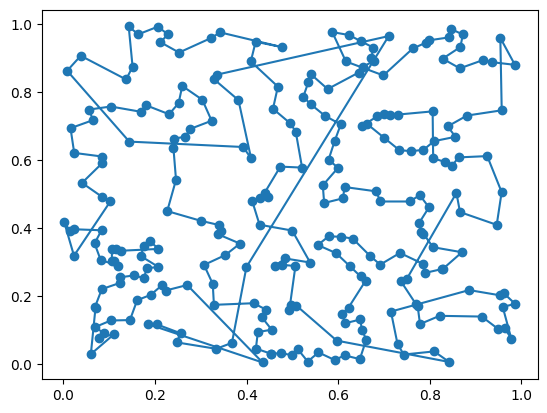

glouton ville 233 : 14.68718273085568


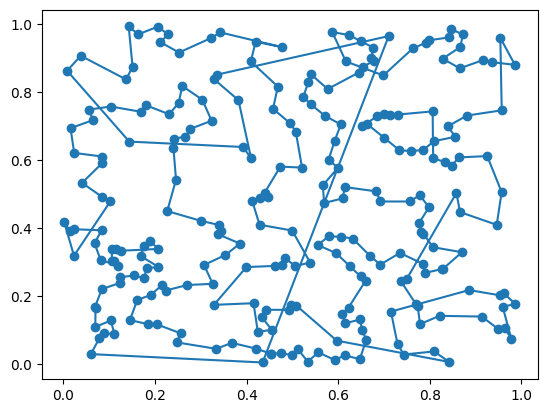

glouton ville 234 : 14.56337801075522


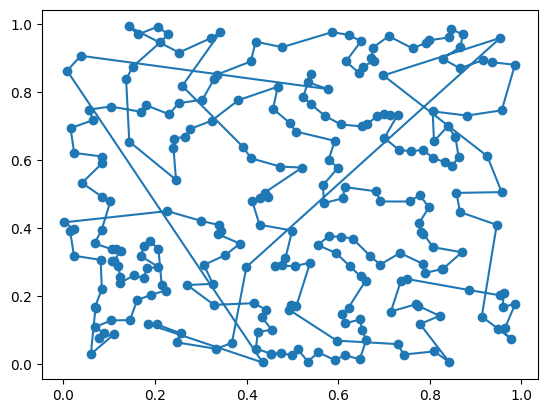

glouton ville 235 : 15.857709152118957


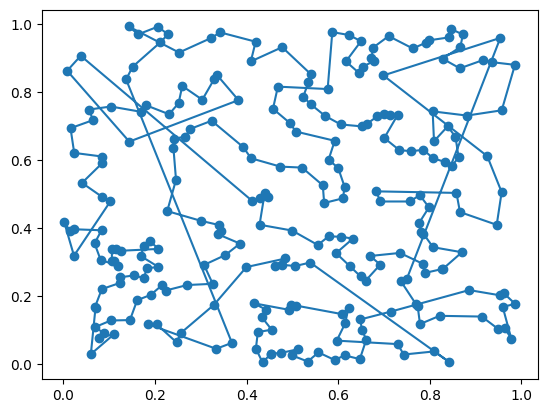

glouton ville 236 : 15.491461296581848


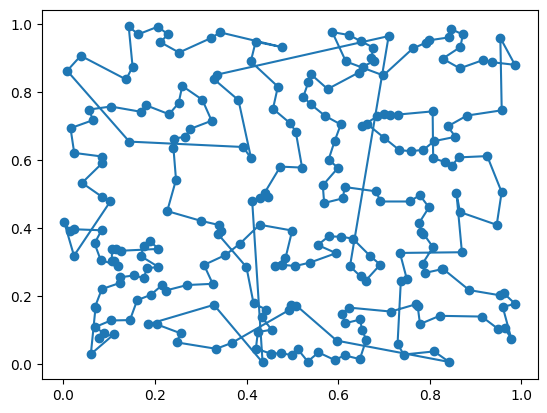

glouton ville 237 : 14.70829085232184


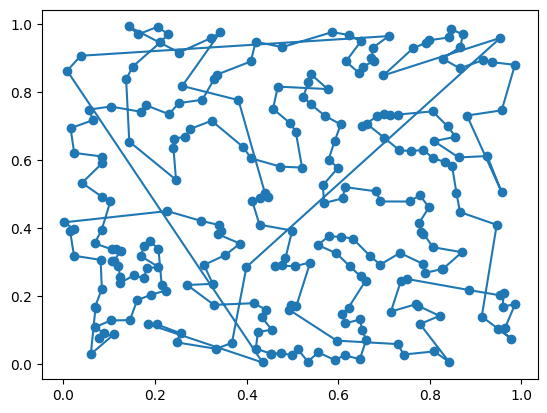

glouton ville 238 : 16.03258924191008


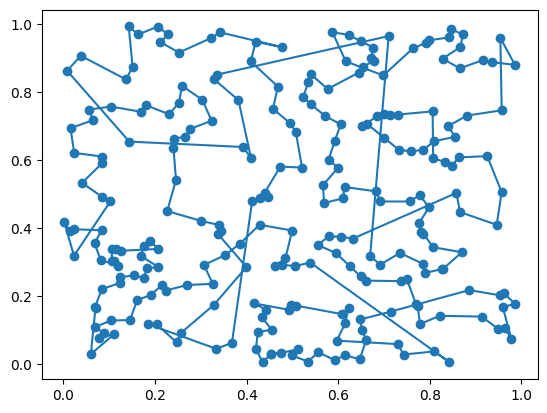

glouton ville 239 : 14.679012520550417


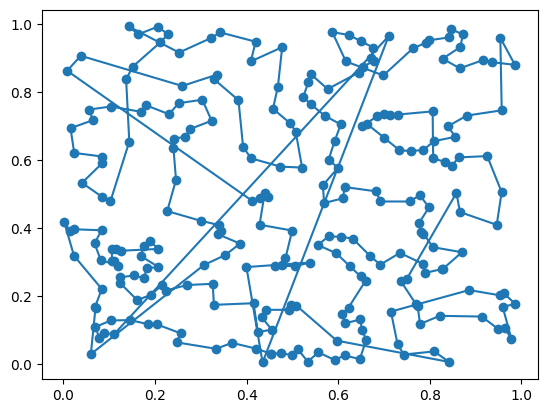

glouton ville 240 : 15.98086893076921


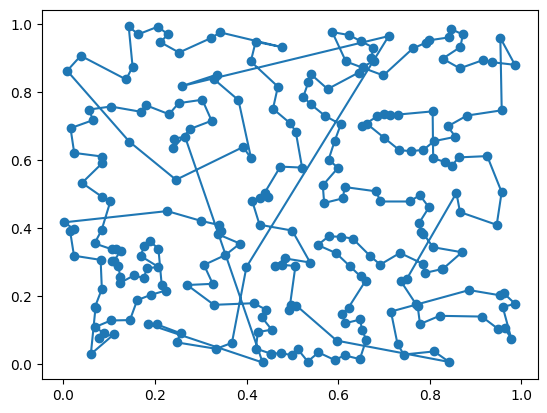

glouton ville 241 : 15.323688335729239


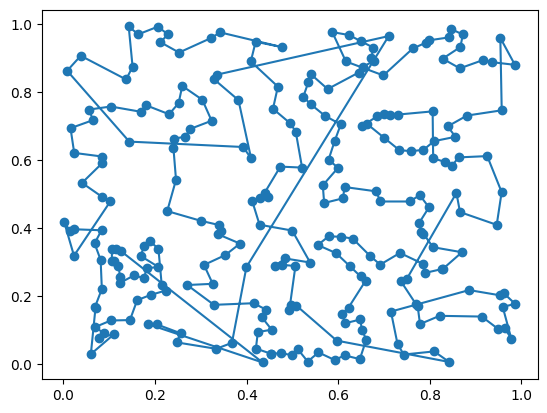

glouton ville 242 : 14.946846392956314


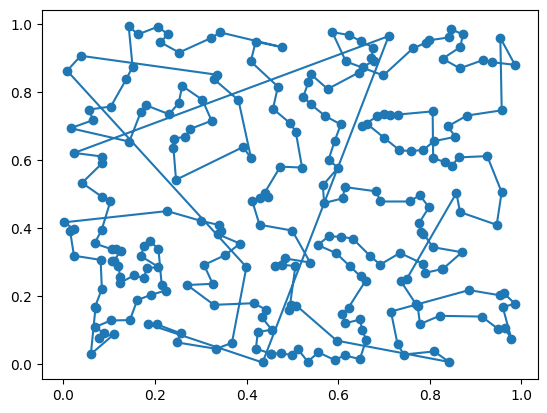

glouton ville 243 : 15.86138728924163


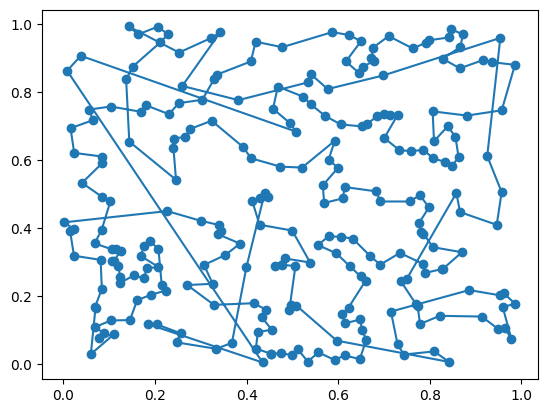

glouton ville 244 : 15.38593323457215


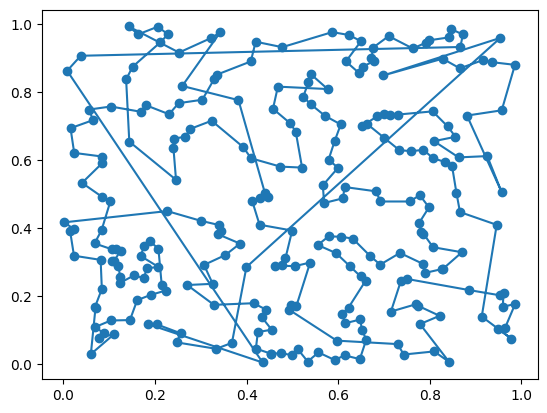

glouton ville 245 : 16.235968313467144


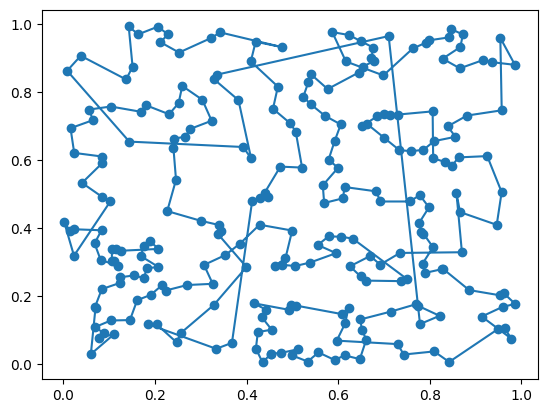

glouton ville 246 : 14.544622388534691


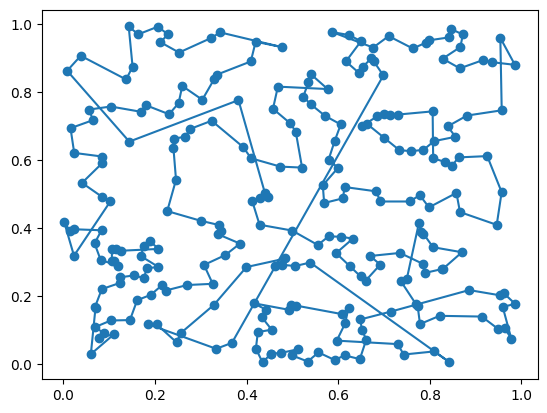

glouton ville 247 : 14.181429278042408


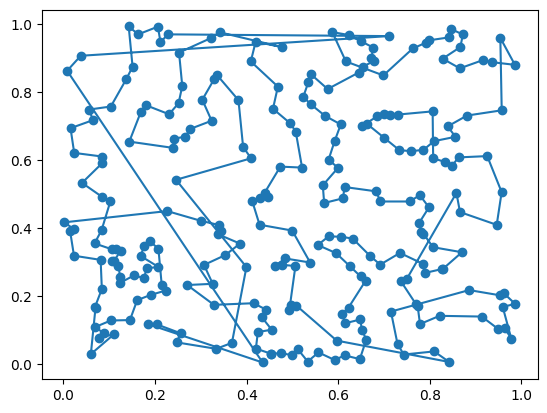

glouton ville 248 : 15.494657699035747


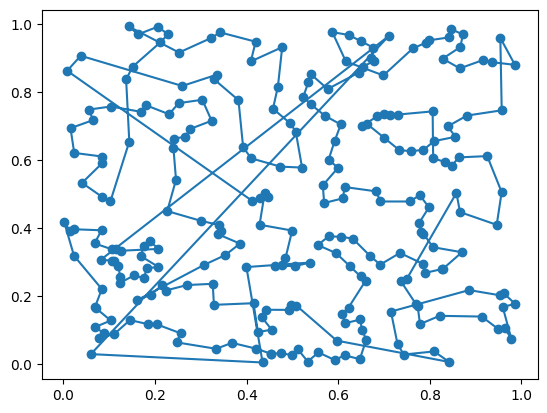

glouton ville 249 : 16.011864344849602
best glouton ville 247 : 14.181429278042408


In [8]:
best = gluttonPerm
bestDist = calcPerm(distEucl, best)
bestI = 0
for i in range(250):
	gluttonPerm = calcGluttonPerm(distEucl, i)
	newDist = calcPerm(distEucl, gluttonPerm)
	if newDist < bestDist:
		best = gluttonPerm
		bestDist = newDist
		bestI = i
	showPerm(gluttonPerm)
	print("glouton ville", i, ":", newDist)

print("best glouton ville", bestI, ":", bestDist)

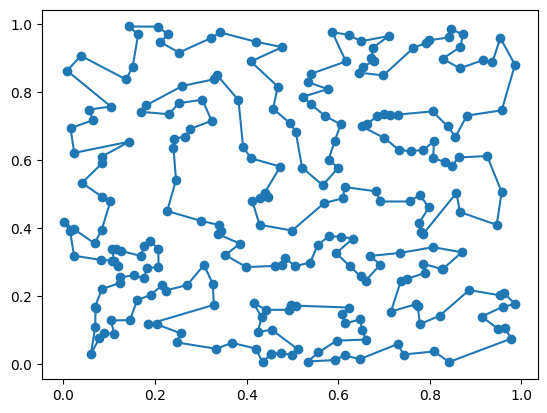

[151, 89, 221, 204, 28, 208, 231, 123, 98, 108, 241, 23, 87, 34, 38, 177, 210, 173, 223, 41, 67, 159, 16, 79, 179, 198, 42, 144, 72, 64, 132, 137, 237, 187, 229, 84, 239, 190, 219, 60, 154, 136, 143, 181, 214, 14, 59, 180, 127, 246, 145, 20, 117, 9, 90, 83, 27, 157, 176, 21, 57, 209, 104, 220, 99, 45, 53, 71, 226, 186, 172, 65, 35, 211, 224, 7, 140, 228, 50, 183, 131, 192, 230, 164, 49, 166, 3, 156, 17, 215, 91, 163, 69, 101, 200, 182, 95, 167, 146, 109, 233, 0, 85, 24, 202, 199, 80, 240, 206, 234, 76, 232, 112, 125, 160, 171, 88, 5, 51, 61, 92, 37, 6, 153, 32, 242, 58, 155, 203, 193, 213, 249, 134, 94, 39, 150, 227, 113, 126, 110, 44, 8, 124, 118, 243, 73, 19, 86, 139, 100, 29, 236, 222, 218, 188, 106, 248, 68, 205, 147, 216, 225, 33, 115, 56, 162, 43, 244, 96, 129, 195, 22, 116, 148, 105, 70, 169, 235, 66, 201, 121, 130, 184, 189, 238, 152, 138, 175, 40, 128, 247, 18, 11, 48, 15, 197, 25, 245, 13, 77, 93, 119, 4, 30, 82, 114, 178, 191, 174, 158, 74, 103, 78, 135, 142, 26, 149, 36, 17

KeyboardInterrupt: 

In [9]:
currentBest = [151, 89, 221, 204, 28, 208, 231, 123, 98, 108, 241, 23, 87, 34, 38, 177, 210, 173, 223, 41, 67, 159, 16, 79, 179, 198, 42, 144, 72, 64, 132, 137, 237, 187, 229, 84, 239, 190, 219, 60, 154, 136, 143, 181, 214, 14, 59, 180, 127, 246, 145, 20, 117, 9, 90, 83, 27, 157, 176, 21, 57, 209, 104, 220, 99, 45, 53, 71, 226, 186, 172, 65, 35, 211, 224, 7, 140, 228, 50, 183, 131, 192, 230, 164, 49, 166, 3, 156, 17, 215, 91, 163, 69, 101, 200, 182, 95, 167, 146, 109, 233, 0, 85, 24, 202, 199, 80, 240, 206, 234, 76, 232, 112, 125, 160, 171, 88, 5, 51, 61, 92, 37, 6, 153, 32, 242, 58, 155, 203, 193, 213, 249, 134, 94, 39, 150, 227, 113, 126, 110, 44, 8, 124, 118, 243, 73, 19, 86, 139, 100, 29, 236, 222, 218, 188, 106, 248, 68, 205, 147, 216, 225, 33, 115, 56, 162, 43, 244, 96, 129, 195, 22, 116, 148, 105, 70, 169, 235, 66, 201, 121, 130, 184, 189, 238, 152, 138, 175, 40, 128, 247, 18, 11, 48, 15, 197, 25, 245, 13, 77, 93, 119, 4, 30, 82, 114, 178, 191, 174, 158, 74, 103, 78, 135, 142, 26, 149, 36, 170, 62, 194, 54, 75, 63, 141, 168, 185, 31, 217, 52, 196, 107, 212, 10, 97, 165, 120, 207, 102, 2, 122, 161, 46, 55, 1, 12, 47, 111, 81, 133]
showPerm(currentBest)
print(currentBest)
print(calcPerm(distEucl, currentBest))
# best = calcGluttonPerm(distEucl, 0)
best = currentBest
alphaTarget = 0.85
kTarget = 95
LTarget = 5
while True:
	alphaTarget, kTarget, _, LTarget, best = surface(best, alphaTarget, kTarget, LTarget)